In [1]:
import yt
import netCDF4 as nc
import pyart
import matplotlib.pyplot as plt
import pygrib
import pandas as pd
import xarray as xr
import cfgrib
import ipywidgets
import numpy as np


## You are using the Python ARM Radar Toolkit (Py-ART), an open source
## library for working with weather radar data. Py-ART is partly
## supported by the U.S. Department of Energy as part of the Atmospheric
## Radiation Measurement (ARM) Climate Research Facility, an Office of
## Science user facility.
##
## If you use this software to prepare a publication, please cite:
##
##     JJ Helmus and SM Collis, JORS 2016, doi: 10.5334/jors.119



[Reading GRIB files](https://youtu.be/yLoudFv3hAY)

[Delving into unknown NDFD GRIB data](https://youtu.be/kEhcJP3G0xw)

In [3]:
fireJan7 = nc.Dataset('data/Boulder_Fire_Event/20090107_0000.nc')
fireJan8 = nc.Dataset('data/Boulder_Fire_Event/20090108_0000.nc')

In [4]:
fireJan7

<class 'netCDF4._netCDF4.Dataset'>
root group (NETCDF3_CLASSIC data model, file format NETCDF3):
    comment0: First mandatory level is surface level
    version: Forecast Systems Lab 1.4
    dimensions(sizes): recNum(1336), manLevel(22), sigTLevel(150), sigWLevel(76), mWndNum(4), mTropNum(4), staNameLen(6)
    variables(dimensions): int32 wmoStaNum(recNum), |S1 staName(recNum, staNameLen), float32 staLat(recNum), float32 staLon(recNum), float32 staElev(recNum), float64 synTime(recNum), int32 numMand(recNum), int32 numSigT(recNum), int32 numSigW(recNum), int32 numMwnd(recNum), int32 numTrop(recNum), float64 relTime(recNum), int32 sondTyp(recNum), float32 prMan(recNum, manLevel), float32 htMan(recNum, manLevel), float32 tpMan(recNum, manLevel), float32 tdMan(recNum, manLevel), float32 wdMan(recNum, manLevel), float32 wsMan(recNum, manLevel), float32 prSigT(recNum, sigTLevel), float32 tpSigT(recNum, sigTLevel), float32 tdSigT(recNum, sigTLevel), float32 htSigW(recNum, sigWLevel), float32

In [5]:
fireJan8

<class 'netCDF4._netCDF4.Dataset'>
root group (NETCDF3_CLASSIC data model, file format NETCDF3):
    comment0: First mandatory level is surface level
    version: Forecast Systems Lab 1.4
    dimensions(sizes): recNum(1309), manLevel(22), sigTLevel(150), sigWLevel(76), mWndNum(4), mTropNum(4), staNameLen(6)
    variables(dimensions): int32 wmoStaNum(recNum), |S1 staName(recNum, staNameLen), float32 staLat(recNum), float32 staLon(recNum), float32 staElev(recNum), float64 synTime(recNum), int32 numMand(recNum), int32 numSigT(recNum), int32 numSigW(recNum), int32 numMwnd(recNum), int32 numTrop(recNum), float64 relTime(recNum), int32 sondTyp(recNum), float32 prMan(recNum, manLevel), float32 htMan(recNum, manLevel), float32 tpMan(recNum, manLevel), float32 tdMan(recNum, manLevel), float32 wdMan(recNum, manLevel), float32 wsMan(recNum, manLevel), float32 prSigT(recNum, sigTLevel), float32 tpSigT(recNum, sigTLevel), float32 tdSigT(recNum, sigTLevel), float32 htSigW(recNum, sigWLevel), float32

/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/pyart/io/nexrad_archive.py:217: UserWarning: Gate spacing is not constant, interpolating data in scans [4, 5, 6] for moment REF.
  UserWarning)


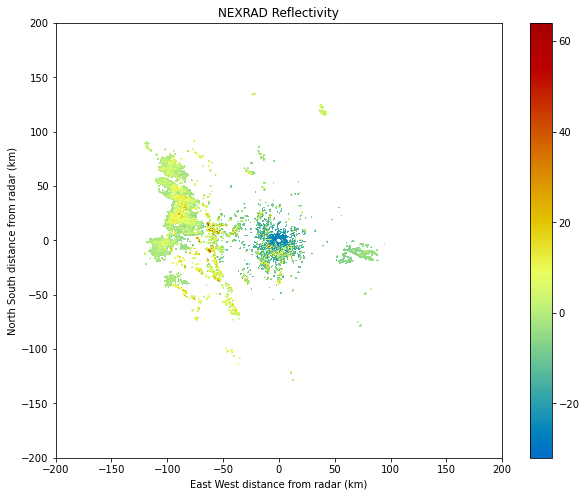

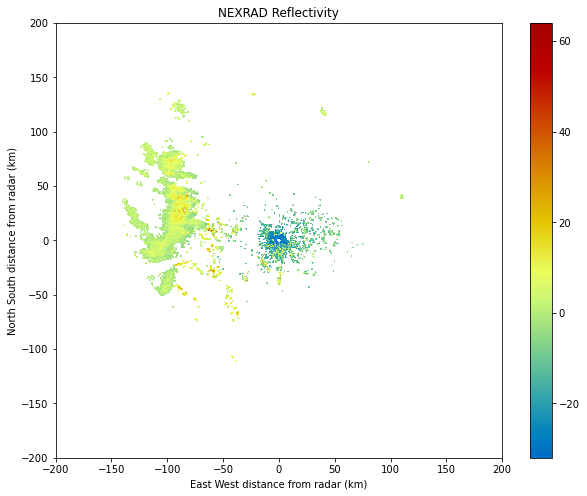

In [6]:
radar = pyart.io.read('data/Boulder_Fire_Event/RADAR/KFTG_20090107_0001.ar2v')
radar1 = pyart.io.read('data/Boulder_Fire_Event/RADAR/KFTG_20090107_0405.ar2v')

display = pyart.graph.RadarDisplay(radar)
fig = plt.figure(figsize=(10, 8))

# plot super resolution reflectivity
ax = fig.add_subplot(111)
display.plot('reflectivity', 0, title='NEXRAD Reflectivity',
             vmin=-32, vmax=64, colorbar_label='', ax=ax)
display.plot_range_ring(radar.range['data'][-1]/1000., ax=ax)
display.set_limits(xlim=(-200, 200), ylim=(-200, 200), ax=ax)
plt.show()
display = pyart.graph.RadarDisplay(radar1)
fig = plt.figure(figsize=(10, 8))

# plot super resolution reflectivity
ax = fig.add_subplot(111)
display.plot('reflectivity', 0, title='NEXRAD Reflectivity',
             vmin=-32, vmax=64, colorbar_label='', ax=ax)
display.plot_range_ring(radar.range['data'][-1]/1000., ax=ax)
display.set_limits(xlim=(-200, 200), ylim=(-200, 200), ax=ax)
plt.show()

In [2]:
import os
# assign directory
directory = 'data/Boulder_Fire_Event/RADAR/'
radar_files = []
# iterate over files in
# that directory
for filename in os.listdir(directory):
    f = os.path.join(directory, filename)
    # checking if it is a file
    if os.path.isfile(f):
        radar_files.append(f)

In [3]:
radar_files.sort()
len(radar_files)

148

In [4]:
radar_dd = ipywidgets.Dropdown(options = radar_files)
radar_dd

Dropdown(options=('data/Boulder_Fire_Event/RADAR/KFTG_20090107_0001.ar2v', 'data/Boulder_Fire_Event/RADAR/KFTG…

In [5]:
@ipywidgets.interact(radar=radar_dd,file = (0,147,1))
def radar_plot(file):
    radar = pyart.io.read(radar_files[file])
    plt.clf

    display = pyart.graph.RadarDisplay(radar)
    fig = plt.figure(figsize=(10, 8))

    # plot super resolution reflectivity
    ax = fig.add_subplot(111)
    display.plot('reflectivity', 0, title=f'NEXRAD Reflectivity {file}',
                 vmin=-32, vmax=64, colorbar_label='', ax=ax)
    display.plot_range_ring(radar.range['data'][-1]/1000., ax=ax)
    display.set_limits(xlim=(-200, 200), ylim=(-200, 200), ax=ax)
    display.save

/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/ipykernel/pylab/backend_inline.py:14: DeprecationWarning: `ipykernel.pylab.backend_inline` is deprecated, directly use `matplotlib_inline.backend_inline`
  DeprecationWarning


interactive(children=(IntSlider(value=73, description='file', max=147), Output()), _dom_classes=('widget-inter…

In [2]:
conus = pygrib.open('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2')

In [7]:
grb = conus[600]

In [8]:
conus.tell()

0

In [9]:
data, lat, lon = grb.data() #same as lat,lon = grb.latlons()
lat.min(),lat.max()

(12.190000000000017, 61.30935757335816)

In [10]:
lon.max(),lon.min()

(-49.415986585644376, -152.87862250405013)

In [11]:
lat.shape

(428, 614)

In [12]:
grb.data()

(array([[-12.47387695, -12.34887695, -12.34887695, ...,  -8.22387695,
          -8.09887695,  -8.09887695],
        [-12.34887695, -12.34887695, -12.34887695, ...,  -8.22387695,
          -8.09887695,  -7.97387695],
        [-12.22387695, -12.34887695, -12.22387695, ...,  -8.09887695,
          -7.97387695,  -7.84887695],
        ...,
        [  1.40112305,   1.52612305,   1.65112305, ...,  -3.47387695,
          -3.34887695,  -3.22387695],
        [  1.65112305,   1.77612305,   1.90112305, ...,  -3.59887695,
          -3.47387695,  -3.47387695],
        [  1.77612305,   1.90112305,   2.02612305, ...,  -3.97387695,
          -3.97387695,  -4.09887695]]),
 array([[12.19      , 12.21990762, 12.24973893, ..., 14.38904238,
         14.36560516, 14.34208538],
        [12.29273251, 12.32267489, 12.35254086, ..., 14.49429696,
         14.47083322, 14.44728683],
        [12.39549779, 12.4254749 , 12.45537549, ..., 14.59958178,
         14.57609156, 14.55251859],
        ...,
        [54.394213

In [13]:
conus.read()

[1:2 metre relative humidity:% (instant):lambert:heightAboveGround:level 2 m:fcst time 0 hrs:from 200901071200,
 2:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 20000 Pa:fcst time 0 hrs:from 200901071200,
 3:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 25000 Pa:fcst time 0 hrs:from 200901071200,
 4:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 30000 Pa:fcst time 0 hrs:from 200901071200,
 5:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 40000 Pa:fcst time 0 hrs:from 200901071200,
 6:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 55000 Pa:fcst time 0 hrs:from 200901071200,
 7:MSLP (Eta model reduction):Pa (instant):lambert:meanSea:level 0:fcst time 0 hrs:from 200901071200,
 8:V component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 10000 Pa:fcst time 0 hrs:from 200901071200,
 9:Geopotential height:gpm (instant):lambert:isobaricInhPa:level 20000 Pa:fcst time 0 hrs:from 200901071200,
 10:

In [100]:
conus[4].messagenumber

4

In [68]:
grb.keys()

['globalDomain',
 'GRIBEditionNumber',
 'tablesVersionLatestOfficial',
 'tablesVersionLatest',
 'grib2divider',
 'angleSubdivisions',
 'missingValue',
 'ieeeFloats',
 'isHindcast',
 'section0Length',
 'identifier',
 'discipline',
 'editionNumber',
 'totalLength',
 'sectionNumber',
 'section1Length',
 'numberOfSection',
 'centre',
 'centreDescription',
 'subCentre',
 'tablesVersion',
 'masterDir',
 'localTablesVersion',
 'significanceOfReferenceTime',
 'year',
 'month',
 'day',
 'hour',
 'minute',
 'second',
 'dataDate',
 'julianDay',
 'dataTime',
 'productionStatusOfProcessedData',
 'typeOfProcessedData',
 'md5Section1',
 'selectStepTemplateInterval',
 'selectStepTemplateInstant',
 'stepType',
 'is_chemical',
 'is_chemical_distfn',
 'is_chemical_srcsink',
 'is_aerosol',
 'is_aerosol_optical',
 'setCalendarId',
 'deleteCalendarId',
 'sectionNumber',
 'grib2LocalSectionPresent',
 'deleteLocalDefinition',
 'sectionNumber',
 'gridDescriptionSectionPresent',
 'section3Length',
 'numberOfSec

In [33]:
conus = pygrib.open('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2')
conus.seek(0)
grib_cols = ['messagenumber', 'name', 'units','gridType','typeOfLevel','level','forecastTime']
grib_key_df = pd.DataFrame([[getattr(grib,key) for key in grib_cols] for grib in conus], columns = grib_cols)
grib_key_df.set_index('messagenumber')

,name,units,gridType,typeOfLevel,level,forecastTime
messagenumber,,,,,,
1,2 metre relative humidity,%,lambert,heightAboveGround,2,0
2,Vertical velocity,Pa s**-1,lambert,isobaricInhPa,200,0
3,Vertical velocity,Pa s**-1,lambert,isobaricInhPa,250,0
4,Vertical velocity,Pa s**-1,lambert,isobaricInhPa,300,0
5,Vertical velocity,Pa s**-1,lambert,isobaricInhPa,400,0
...,...,...,...,...,...,...
7041,Maximum temperature,K,lambert,heightAboveGround,2,78
7042,Probability of 0.01 inch of precipitation (POP),%,lambert,surface,0,78
7043,10 metre wind speed,m s**-1,lambert,heightAboveGround,10,81


In [34]:
grib_key_df.sort_values('level')

,messagenumber,name,units,gridType,typeOfLevel,level,forecastTime
4678,4679,Convective precipitation (water),kg m**-2,lambert,surface,0,57
681,682,Geopotential height,gpm,lambert,isothermZero,0,6
682,683,Relative humidity,%,lambert,sigmaLayer,0,6
683,684,Visibility,m,lambert,surface,0,6
684,685,U component of wind,m s**-1,lambert,maxWind,0,6
...,...,...,...,...,...,...,...
6463,6464,Convective available potential energy,J kg**-1,lambert,pressureFromGroundLayer,18000,81
2058,2059,Convective available potential energy,J kg**-1,lambert,pressureFromGroundLayer,18000,24
3729,3730,Convective available potential energy,J kg**-1,lambert,pressureFromGroundLayer,18000,45
2327,2328,Best (4-layer) lifted index,K,lambert,pressureFromGroundLayer,18000,27


In [21]:
grib_key_df.typeOfLevel.unique()

array(['heightAboveGround', 'isobaricInhPa', 'meanSea', 'surface',
       'pressureFromGroundLayer', 'sigmaLayer', 'isothermZero',
       'heightAboveGroundLayer', 'tropopause', 'atmosphereSingleLayer',
       'isobaricLayer', 'maxWind', 'hybrid'], dtype=object)

In [50]:
grib_key_df.name.unique()

array(['2 metre relative humidity', 'Vertical velocity',
       'MSLP (Eta model reduction)', 'V component of wind',
       'Geopotential height', 'Pressure reduced to MSL', 'Temperature',
       'Absolute vorticity', '2 metre temperature',
       '10 metre V wind component', '10 metre U wind component',
       'U component of wind', 'Surface pressure', 'Relative humidity',
       'Categorical snow', 'Convective available potential energy',
       'Parcel lifted index (to 500 hPa)', 'Categorical ice pellets',
       'Storm relative helicity', 'Categorical rain',
       'Water equivalent of accumulated snow depth (deprecated)',
       'Best (4-layer) lifted index', 'Precipitable water',
       'Surface lifted index', 'Categorical freezing rain',
       'Total Cloud Cover', 'Convective inhibition',
       'Tropopause pressure', 'Visibility', 'Pressure',
       'Maximum/Composite radar reflectivity', 'Snow depth',
       'Derived radar reflectivity', 'Convective precipitation (water)',
  

In [3]:
grib_key_df.to_xarray()

NameError: name 'grib_key_df' is not defined

In [48]:
ds = xr.load_dataset('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2', engine='cfgrib', filter_by_keys={'typeOfLevel': 'isobaricInhPa'})


Ignoring index file 'data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2.923a8.idx' incompatible with GRIB file
skipping variable: paramId==3041 shortName='absv'
Traceback (most recent call last):
  File "/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/cfgrib/dataset.py", line 660, in build_dataset_components
    dict_merge(variables, coord_vars)
  File "/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/cfgrib/dataset.py", line 593, in dict_merge
    "key=%r value=%r new_value=%r" % (key, master[key], value)
cfgrib.dataset.DatasetBuildError: key present and new value is different: key='isobaricInhPa' value=Variable(dimensions=('isobaricInhPa',), data=array([1000.,  975.,  950.,  925.,  900.,  875.,  850.,  825.,  800.,
        775.,  750.,  725.,  700.,  675.,  650.,  625.,  600.,  575.,
        550.,  525.,  500.,  450.,  400.,  350.,  300.,  250.,  200.,
        150.,  100.])) new_value=Variable(dimensions=('isobaricInhPa',), data=array([10

In [49]:
ds

<xarray.Dataset>
Dimensions:        (step: 29, isobaricInhPa: 29, y: 428, x: 614)
Coordinates:
    time           datetime64[ns] 2009-01-07T12:00:00
  * step           (step) timedelta64[ns] 0 days 00:00:00 ... 3 days 12:00:00
  * isobaricInhPa  (isobaricInhPa) float64 1e+03 975.0 950.0 ... 150.0 100.0
    latitude       (y, x) float64 12.19 12.22 12.25 12.28 ... 57.39 57.36 57.33
    longitude      (y, x) float64 226.5 226.6 226.8 226.9 ... 310.3 310.4 310.6
    valid_time     (step) datetime64[ns] 2009-01-07T12:00:00 ... 2009-01-11
Dimensions without coordinates: y, x
Data variables:
    w              (step, isobaricInhPa, y, x) float32 0.02198 ... 0.001136
    v              (step, isobaricInhPa, y, x) float32 -5.217 -5.217 ... 19.7
    gh             (step, isobaricInhPa, y, x) float32 109.1 109.6 ... 1.56e+04
    t              (step, isobaricInhPa, y, x) float32 296.2 296.2 ... 220.1
    u              (step, isobaricInhPa, y, x) float32 -11.89 -11.76 ... 15.34
Attributes:
    GRIB_edition:            2
    GRIB_centre:             kwbc
    GRIB_centreDescription:  US National Weather Service - NCEP
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             US National Weather Service - NCEP
    history:                 2022-06-14T11:53 GRIB to CDM+CF via cfgrib-0.9.1...

(array([2.70400000e+04, 2.90181000e+05, 2.34983200e+06, 2.48054880e+07,
        1.58507601e+08, 2.96867390e+07, 3.97749400e+06, 1.02446000e+06,
        3.02349000e+05, 3.68880000e+04]),
 array([-78.89761 , -61.854668, -44.811726, -27.76878 , -10.725836,
          6.317108,  23.360052,  40.402996,  57.445942,  74.488884,
         91.53183 ], dtype=float32),
 <a list of 10 Patch objects>)

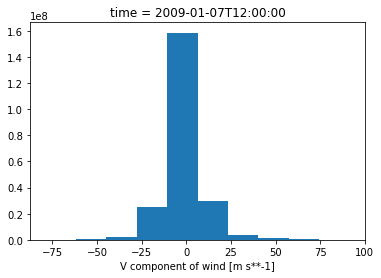

In [17]:
ds.v.plot()

(array([1.9751600e+05, 1.5478670e+07, 8.7461427e+07, 6.8968611e+07,
        3.4952409e+07, 1.0687628e+07, 2.7498350e+06, 4.6148100e+05,
        4.5965000e+04, 4.5300000e+03]),
 array([-32.87561 , -19.436623,  -5.997635,   7.441353,  20.88034 ,
         34.31933 ,  47.758316,  61.197304,  74.63629 ,  88.07528 ,
        101.51427 ], dtype=float32),
 <a list of 10 Patch objects>)

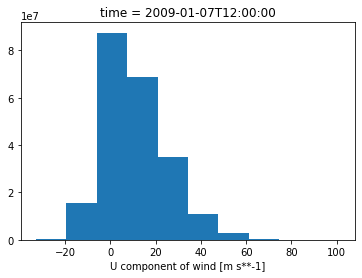

In [18]:
ds.u.plot()

In [52]:
ds = xr.load_dataset('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2', engine='cfgrib', filter_by_keys={'typeOfLevel': 'tropopause'})


In [53]:
ds

<xarray.Dataset>
Dimensions:     (step: 29, y: 428, x: 614)
Coordinates:
    time        datetime64[ns] 2009-01-07T12:00:00
  * step        (step) timedelta64[ns] 0 days 00:00:00 ... 3 days 12:00:00
    tropopause  float64 0.0
    latitude    (y, x) float64 12.19 12.22 12.25 12.28 ... 57.39 57.36 57.33
    longitude   (y, x) float64 226.5 226.6 226.8 226.9 ... 310.3 310.4 310.6
    valid_time  (step) datetime64[ns] 2009-01-07T12:00:00 ... 2009-01-11
Dimensions without coordinates: y, x
Data variables:
    u           (step, y, x) float32 18.45 18.45 23.57 ... 4.464 4.589 4.589
    trpp        (step, y, x) float32 1.147e+04 1.147e+04 ... 2.827e+04 2.827e+04
    t           (step, y, x) float32 200.8 200.9 202.2 ... 218.3 218.3 218.3
    v           (step, y, x) float32 -8.984 -9.234 -16.86 ... 6.939 6.814 6.689
Attributes:
    GRIB_edition:            2
    GRIB_centre:             kwbc
    GRIB_centreDescription:  US National Weather Service - NCEP
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             US National Weather Service - NCEP
    history:                 2022-06-01T11:10 GRIB to CDM+CF via cfgrib-0.9.1...

In [63]:
for i in ds.data_vars:
    print(ds[i].GRIB_name)

Vertical velocity
V component of wind
Geopotential height
Temperature
U component of wind


In [14]:
lon

array([[-133.459     , -133.35389085, -133.24873431, ...,  -65.34276887,
         -65.23414071,  -65.12555139],
       [-133.48966029, -133.38447651, -133.27924523, ...,  -65.31859589,
         -65.20988495,  -65.10121294],
       [-133.52036817, -133.41510967, -133.30980355, ...,  -65.29438411,
         -65.18559027,  -65.07683545],
       ...,
       [-152.74480881, -152.59758855, -152.4502235 , ...,  -49.84322959,
         -49.6848239 ,  -49.52654667],
       [-152.81164297, -152.66429559, -152.51680298, ...,  -49.78833966,
         -49.62977099,  -49.47133121],
       [-152.8786225 , -152.73114787, -152.58352756, ...,  -49.73332112,
         -49.5745892 ,  -49.41598659]])

In [15]:
for i in lat:
    print(i)

[12.19       12.21990762 12.24973893 12.27949382 12.30917223 12.33877405
 12.3682992  12.3977476  12.42711916 12.45641379 12.48563141 12.51477193
 12.54383526 12.57282133 12.60173004 12.63056131 12.65931506 12.6879912
 12.71658965 12.74511033 12.77355315 12.80191802 12.83020488 12.85841362
 12.88654418 12.91459646 12.94257039 12.97046589 12.99828287 13.02602125
 13.05368095 13.0812619  13.108764   13.13618719 13.16353138 13.19079649
 13.21798244 13.24508915 13.27211655 13.29906455 13.32593308 13.35272206
 13.37943141 13.40606105 13.43261091 13.45908091 13.48547097 13.51178101
 13.53801097 13.56416076 13.5902303  13.61621953 13.64212837 13.66795674
 13.69370456 13.71937177 13.74495829 13.77046404 13.79588895 13.82123294
 13.84649596 13.87167791 13.89677873 13.92179835 13.94673669 13.97159368
 13.99636925 14.02106333 14.04567585 14.07020673 14.09465591 14.11902332
 14.14330888 14.16751252 14.19163419 14.21567379 14.23963128 14.26350657
 14.2872996  14.31101031 14.33463861 14.35818445 14.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [16]:
len(lat[1][:])

614

In [17]:
temp = conus.select(name = 'Temperature')
temp

[15:Temperature:K (instant):lambert:isobaricInhPa:level 10000 Pa:fcst time 0 hrs:from 200901071200,
 21:Temperature:K (instant):lambert:isobaricInhPa:level 15000 Pa:fcst time 0 hrs:from 200901071200,
 28:Temperature:K (instant):lambert:isobaricInhPa:level 35000 Pa:fcst time 0 hrs:from 200901071200,
 31:Temperature:K (instant):lambert:isobaricInhPa:level 30000 Pa:fcst time 0 hrs:from 200901071200,
 39:Temperature:K (instant):lambert:isobaricInhPa:level 20000 Pa:fcst time 0 hrs:from 200901071200,
 49:Temperature:K (instant):lambert:isobaricInhPa:level 25000 Pa:fcst time 0 hrs:from 200901071200,
 51:Temperature:K (instant):lambert:isobaricInhPa:level 57500 Pa:fcst time 0 hrs:from 200901071200,
 55:Temperature:K (instant):lambert:isobaricInhPa:level 40000 Pa:fcst time 0 hrs:from 200901071200,
 80:Temperature:K (instant):lambert:isobaricInhPa:level 45000 Pa:fcst time 0 hrs:from 200901071200,
 98:Temperature:K (instant):lambert:isobaricInhPa:level 62500 Pa:fcst time 0 hrs:from 200901071200,


In [18]:
press = conus.select(name = 'Pressure')
press

[216:Pressure:Pa (instant):lambert:maxWind:level 0:fcst time 0 hrs:from 200901071200,
 443:Pressure:Pa (instant):lambert:maxWind:level 0:fcst time 3 hrs:from 200901071200,
 630:Pressure:Pa (instant):lambert:maxWind:level 0:fcst time 6 hrs:from 200901071200,
 897:Pressure:Pa (instant):lambert:maxWind:level 0:fcst time 9 hrs:from 200901071200,
 1162:Pressure:Pa (instant):lambert:maxWind:level 0:fcst time 12 hrs:from 200901071200,
 1345:Pressure:Pa (instant):lambert:maxWind:level 0:fcst time 15 hrs:from 200901071200,
 1599:Pressure:Pa (instant):lambert:maxWind:level 0:fcst time 18 hrs:from 200901071200,
 1849:Pressure:Pa (instant):lambert:maxWind:level 0:fcst time 21 hrs:from 200901071200,
 2074:Pressure:Pa (instant):lambert:maxWind:level 0:fcst time 24 hrs:from 200901071200,
 2319:Pressure:Pa (instant):lambert:maxWind:level 0:fcst time 27 hrs:from 200901071200,
 2548:Pressure:Pa (instant):lambert:maxWind:level 0:fcst time 30 hrs:from 200901071200,
 2787:Pressure:Pa (instant):lambert:maxW

In [19]:
wind_v = conus.select(name='V component of wind')
wind_v

[8:V component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 10000 Pa:fcst time 0 hrs:from 200901071200,
 13:V component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 15000 Pa:fcst time 0 hrs:from 200901071200,
 27:V component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 25000 Pa:fcst time 0 hrs:from 200901071200,
 38:V component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 35000 Pa:fcst time 0 hrs:from 200901071200,
 56:V component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 30000 Pa:fcst time 0 hrs:from 200901071200,
 59:V component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 20000 Pa:fcst time 0 hrs:from 200901071200,
 71:V component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 52500 Pa:fcst time 0 hrs:from 200901071200,
 73:V component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 55000 Pa:fcst time 0 hrs:from 200901071200,
 75:V component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 40000 Pa:fcst time 

In [20]:
geopotential_h = conus.select(name = 'Geopotential height')
geopotential_h

[9:Geopotential height:gpm (instant):lambert:isobaricInhPa:level 20000 Pa:fcst time 0 hrs:from 200901071200,
 10:Geopotential height:gpm (instant):lambert:isobaricInhPa:level 15000 Pa:fcst time 0 hrs:from 200901071200,
 16:Geopotential height:gpm (instant):lambert:isobaricInhPa:level 10000 Pa:fcst time 0 hrs:from 200901071200,
 45:Geopotential height:gpm (instant):lambert:isobaricInhPa:level 30000 Pa:fcst time 0 hrs:from 200901071200,
 58:Geopotential height:gpm (instant):lambert:isobaricInhPa:level 50000 Pa:fcst time 0 hrs:from 200901071200,
 64:Geopotential height:gpm (instant):lambert:isobaricInhPa:level 35000 Pa:fcst time 0 hrs:from 200901071200,
 70:Geopotential height:gpm (instant):lambert:isobaricInhPa:level 25000 Pa:fcst time 0 hrs:from 200901071200,
 72:Geopotential height:gpm (instant):lambert:isobaricInhPa:level 57500 Pa:fcst time 0 hrs:from 200901071200,
 81:Geopotential height:gpm (instant):lambert:isobaricInhPa:level 45000 Pa:fcst time 0 hrs:from 200901071200,
 82:Geopote

In [21]:
vertical_v = conus.select(name = 'Vertical velocity')
vertical_v

[2:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 20000 Pa:fcst time 0 hrs:from 200901071200,
 3:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 25000 Pa:fcst time 0 hrs:from 200901071200,
 4:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 30000 Pa:fcst time 0 hrs:from 200901071200,
 5:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 40000 Pa:fcst time 0 hrs:from 200901071200,
 6:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 55000 Pa:fcst time 0 hrs:from 200901071200,
 12:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 10000 Pa:fcst time 0 hrs:from 200901071200,
 14:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 35000 Pa:fcst time 0 hrs:from 200901071200,
 23:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 67500 Pa:fcst time 0 hrs:from 200901071200,
 24:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 77500 Pa:fcst time 0 hrs:from 20

In [22]:
len(vertical_v)

841

In [23]:
len(geopotential_h)

870

In [24]:
len(temp)

1015

In [25]:
len(wind_v)

1044

In [26]:
len(press)

29

In [27]:
grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','typeOfLevel','level','forecastTime')
print(grbindx.keys)
selected_grbs=grbindx(typeOfLevel='isobaricInhPa',level=1000, forecastTime = 0)

['typeOfLevel', 'level', 'forecastTime']


In [28]:
selected_grbs

[1:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200,
 2:Absolute vorticity:s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200,
 3:Temperature:K (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200,
 4:Geopotential height:gpm (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200,
 5:Relative humidity:% (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200,
 6:U component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200,
 7:V component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200]

In [1]:
grb.typeOfLevel

NameError: name 'grb' is not defined

1:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200 [[-133.459      -133.35389085 -133.24873431 ...  -65.34276887
   -65.23414071  -65.12555139]
 [-133.48966029 -133.38447651 -133.27924523 ...  -65.31859589
   -65.20988495  -65.10121294]
 [-133.52036817 -133.41510967 -133.30980355 ...  -65.29438411
   -65.18559027  -65.07683545]
 ...
 [-152.74480881 -152.59758855 -152.4502235  ...  -49.84322959
   -49.6848239   -49.52654667]
 [-152.81164297 -152.66429559 -152.51680298 ...  -49.78833966
   -49.62977099  -49.47133121]
 [-152.8786225  -152.73114787 -152.58352756 ...  -49.73332112
   -49.5745892   -49.41598659]]
2:Absolute vorticity:s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200 [[-133.459      -133.35389085 -133.24873431 ...  -65.34276887
   -65.23414071  -65.12555139]
 [-133.48966029 -133.38447651 -133.27924523 ...  -65.31859589
   -65.20988495  -65.10121294]
 [-133.52036817 -133.41510967 

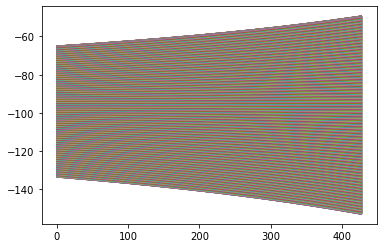

In [30]:
for i in selected_grbs:
    plt.plot(grb.data()[2])
    print(i,grb.data()[2])

1:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200 [[ 0.02198482 -0.00926518 -0.00926518 ...  0.02198482  0.02198482
  -0.00926518]
 [-0.00926518 -0.00926518  0.02198482 ...  0.02198482  0.02198482
  -0.00926518]
 [-0.00926518 -0.00926518 -0.00926518 ...  0.02198482  0.02198482
   0.02198482]
 ...
 [-0.00926518 -0.00926518 -0.00926518 ...  0.02198482  0.02198482
  -0.04051518]
 [-0.00926518  0.02198482  0.02198482 ...  0.02198482  0.02198482
  -0.00926518]
 [-0.00926518  0.02198482  0.02198482 ... -0.00926518  0.02198482
  -0.00926518]]
2:Absolute vorticity:s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200 [[1.84772491e-05 1.84772491e-05 1.84772491e-05 ... 4.34772491e-05
  4.34772491e-05 4.34772491e-05]
 [1.84772491e-05 1.84772491e-05 1.84772491e-05 ... 1.84772491e-05
  4.34772491e-05 4.34772491e-05]
 [1.84772491e-05 1.84772491e-05 1.84772491e-05 ... 1.84772491e-05
  1.84772491e-05 1.84772

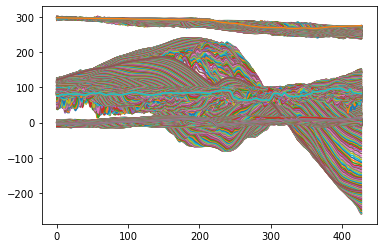

In [31]:
count = 0
for i in selected_grbs:
    grb = selected_grbs[count]
    count+=1
    print(grb,grb.data()[0])
    plt.plot(grb.data()[0])

1:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200
2:Absolute vorticity:s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200
3:Temperature:K (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200
4:Geopotential height:gpm (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200
5:Relative humidity:% (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200
6:U component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200
7:V component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200


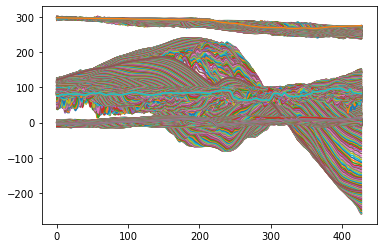

In [32]:
count = 0
for i in selected_grbs:
    grb = selected_grbs[count]
    count+=1
    print(grb)
    plt.plot(grb.data()[0])

1:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200 [[ 0.02198482 -0.00926518 -0.00926518 ...  0.02198482  0.02198482
  -0.00926518]
 [-0.00926518 -0.00926518  0.02198482 ...  0.02198482  0.02198482
  -0.00926518]
 [-0.00926518 -0.00926518 -0.00926518 ...  0.02198482  0.02198482
   0.02198482]
 ...
 [-0.00926518 -0.00926518 -0.00926518 ...  0.02198482  0.02198482
  -0.04051518]
 [-0.00926518  0.02198482  0.02198482 ...  0.02198482  0.02198482
  -0.00926518]
 [-0.00926518  0.02198482  0.02198482 ... -0.00926518  0.02198482
  -0.00926518]]
2:Absolute vorticity:s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200 [[1.84772491e-05 1.84772491e-05 1.84772491e-05 ... 4.34772491e-05
  4.34772491e-05 4.34772491e-05]
 [1.84772491e-05 1.84772491e-05 1.84772491e-05 ... 1.84772491e-05
  4.34772491e-05 4.34772491e-05]
 [1.84772491e-05 1.84772491e-05 1.84772491e-05 ... 1.84772491e-05
  1.84772491e-05 1.84772

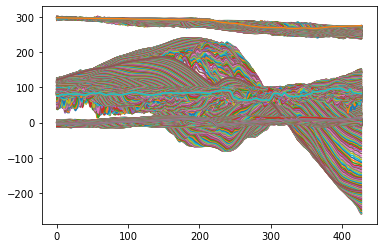

In [33]:
count = 0
for i in selected_grbs:
    grb = selected_grbs[count]
    count += 1
    plt.plot(grb.data()[0])
    print(i,grb.data()[0])

1:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200


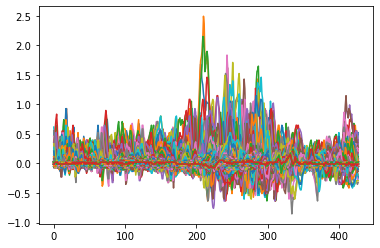

In [34]:
plt.plot(selected_grbs[0].data()[0])
print(selected_grbs[0])

2:Absolute vorticity:s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200


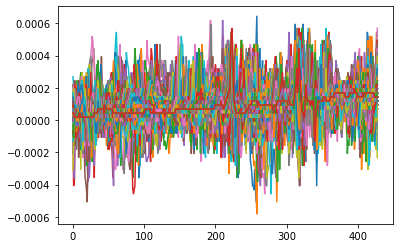

In [35]:
plt.plot(selected_grbs[1].data()[0])
print(selected_grbs[1])

3:Temperature:K (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200


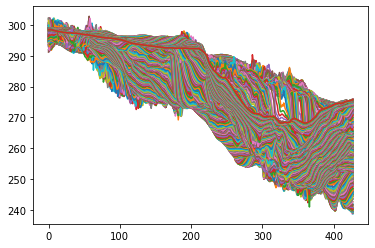

In [36]:
plt.plot(selected_grbs[2].data()[0])
print(selected_grbs[2])

4:Geopotential height:gpm (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200


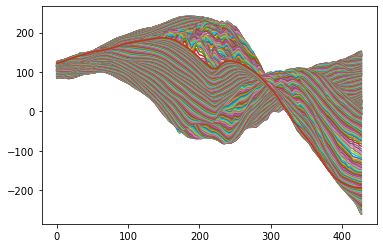

In [37]:
plt.plot(selected_grbs[3].data()[0])
print(selected_grbs[3])

5:Relative humidity:% (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200


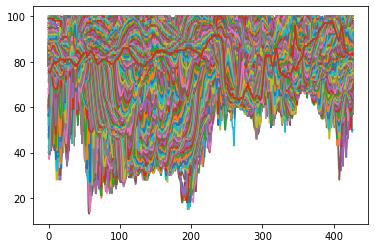

In [38]:
plt.plot(selected_grbs[4].data()[0])
print(selected_grbs[4])

6:U component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200


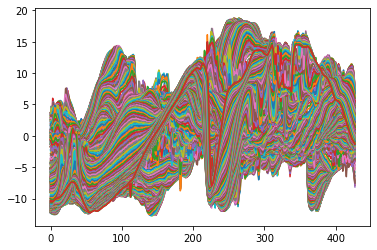

In [39]:
plt.plot(selected_grbs[5].data()[0])
print(selected_grbs[5])

7:V component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200


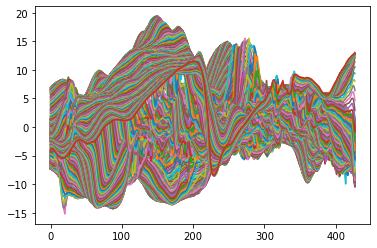

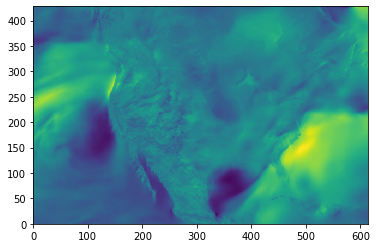

In [40]:
plt.figure()
plt.plot(selected_grbs[6].data()[0])
plt.figure()
plt.pcolormesh(selected_grbs[6].data()[0])
print(selected_grbs[6])

7:V component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 0 hrs:from 200901071200


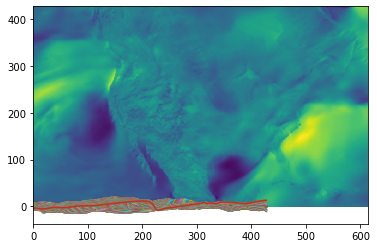

In [41]:
plt.figure()
plt.plot(selected_grbs[6].data()[0])
plt.pcolormesh(selected_grbs[6].data()[0])
print(selected_grbs[6])

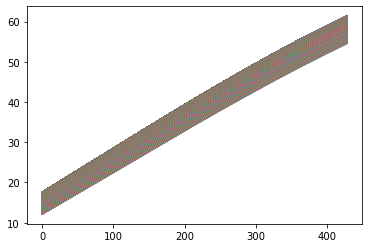

In [42]:
for i in selected_grbs:
    plt.plot(grb.data()[1])

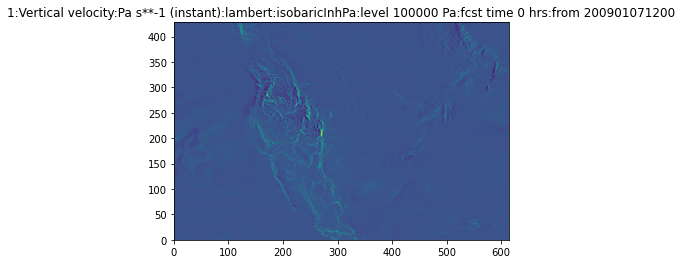

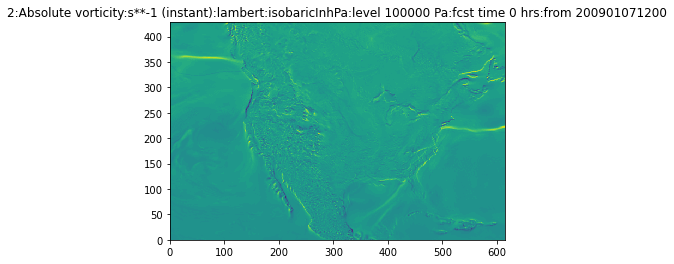

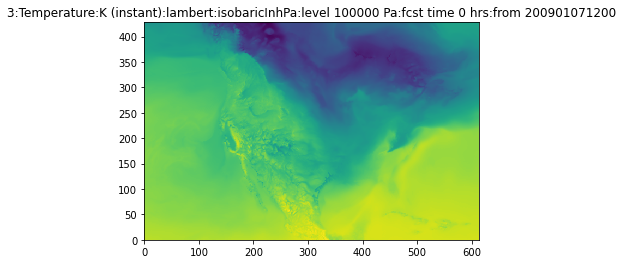

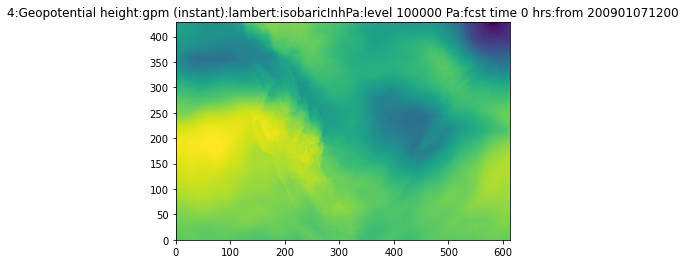

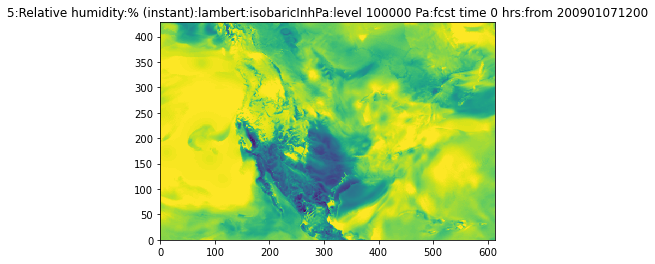

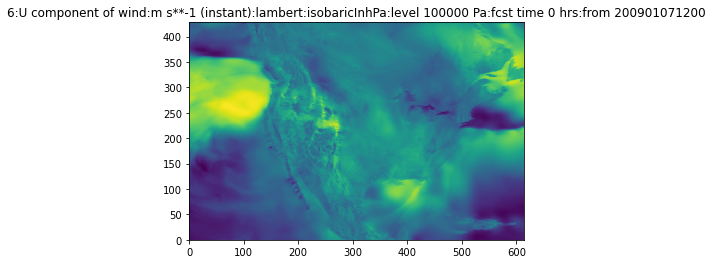

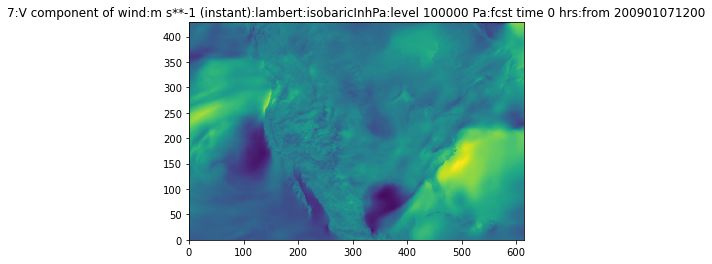

In [43]:
count = 0
for i in selected_grbs:
    plt.figure()
    grb = selected_grbs[count]
    plt.pcolormesh(grb.data()[0])
    plt.title(selected_grbs[count])
    plt.ylabel=('selected_grbs[count].units')
    count += 1
plt.show()

In [62]:
grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','typeOfLevel','level','forecastTime')
selected_grbs_t3_l1000=grbindx(typeOfLevel='isobaricInhPa',level=1000, forecastTime = 3)
selected_grbs_t3_l1000

[1:Absolute vorticity:s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 3 hrs:from 200901071200,
 2:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 3 hrs:from 200901071200,
 3:Geopotential height:gpm (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 3 hrs:from 200901071200,
 4:Temperature:K (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 3 hrs:from 200901071200,
 5:U component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 3 hrs:from 200901071200,
 6:Relative humidity:% (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 3 hrs:from 200901071200,
 7:V component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 100000 Pa:fcst time 3 hrs:from 200901071200]

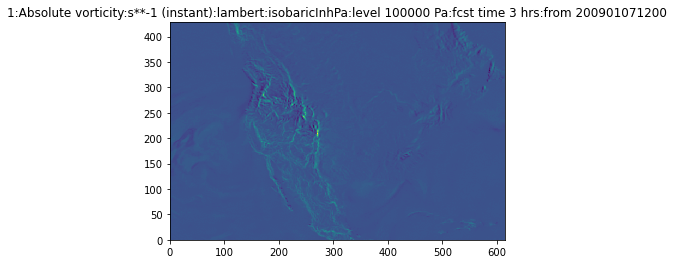

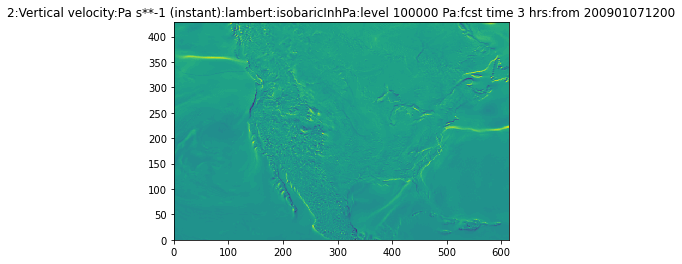

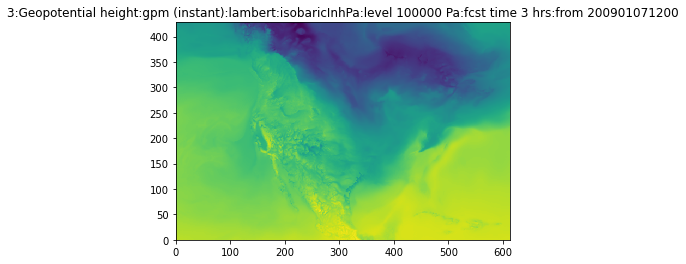

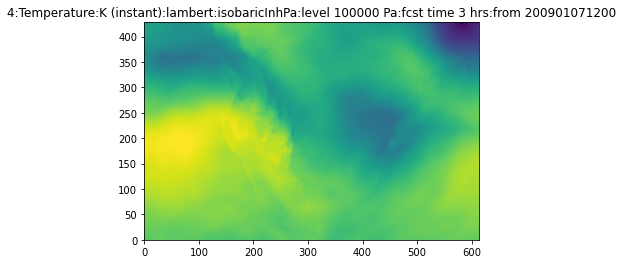

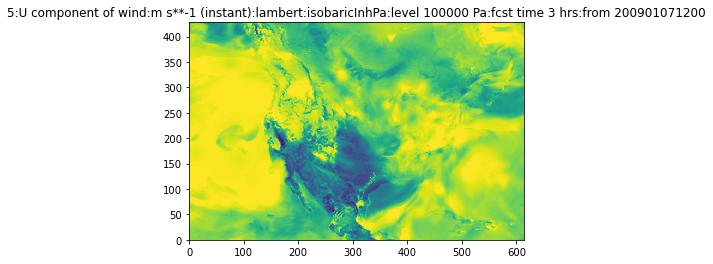

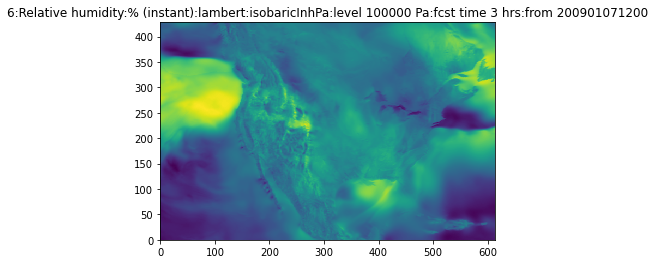

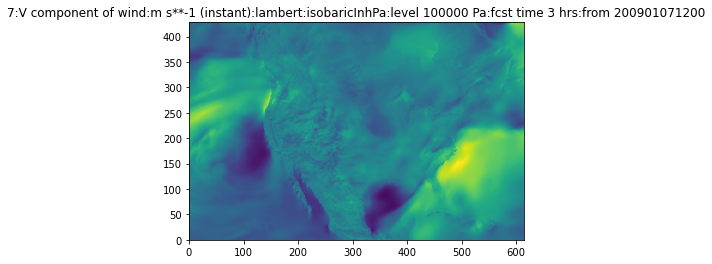

In [63]:
count = 0
for i in selected_grbs_t3_l1000:
    plt.figure()
    grb = selected_grbs[count]
    plt.pcolormesh(grb.data()[0])
    plt.title(selected_grbs_t3_l1000[count])
    plt.ylabel=(selected_grbs_t3_l1000[count].units)
    count += 1
plt.show()

In [50]:
grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','level')
print(grbindx.keys)
selected_grbs_l45000=grbindx(level=450)

['level']


In [51]:
selected_grbs_l45000

[1:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 45000 Pa:fcst time 0 hrs:from 200901071200,
 2:Temperature:K (instant):lambert:isobaricInhPa:level 45000 Pa:fcst time 0 hrs:from 200901071200,
 3:Geopotential height:gpm (instant):lambert:isobaricInhPa:level 45000 Pa:fcst time 0 hrs:from 200901071200,
 4:Relative humidity:% (instant):lambert:isobaricInhPa:level 45000 Pa:fcst time 0 hrs:from 200901071200,
 5:U component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 45000 Pa:fcst time 0 hrs:from 200901071200,
 6:V component of wind:m s**-1 (instant):lambert:isobaricInhPa:level 45000 Pa:fcst time 0 hrs:from 200901071200,
 7:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 45000 Pa:fcst time 3 hrs:from 200901071200,
 8:Geopotential height:gpm (instant):lambert:isobaricInhPa:level 45000 Pa:fcst time 3 hrs:from 200901071200,
 9:Temperature:K (instant):lambert:isobaricInhPa:level 45000 Pa:fcst time 3 hrs:from 200901071200,
 10:U component of wind:m s**

/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figur

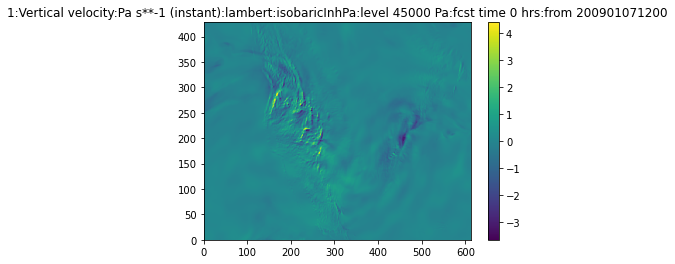

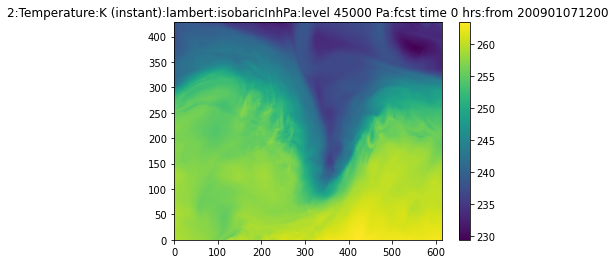

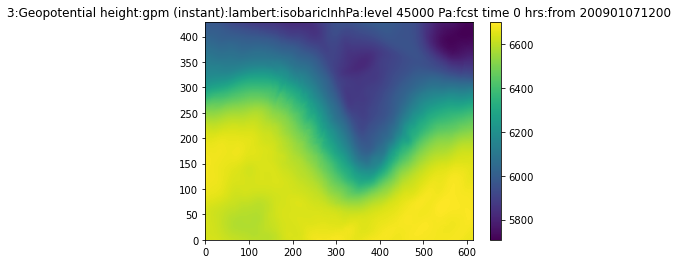

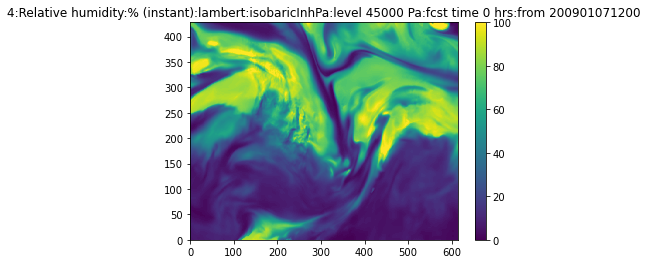

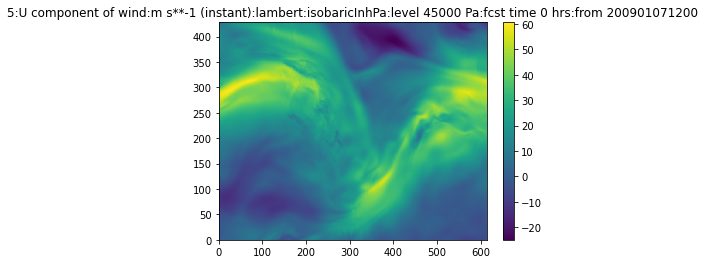

...

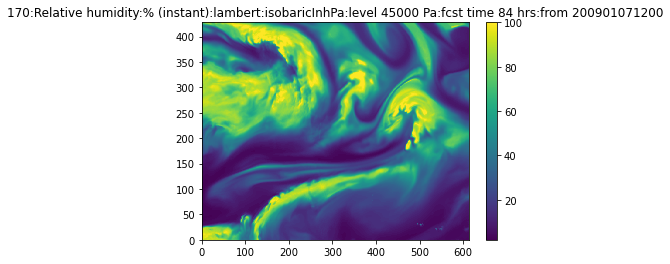

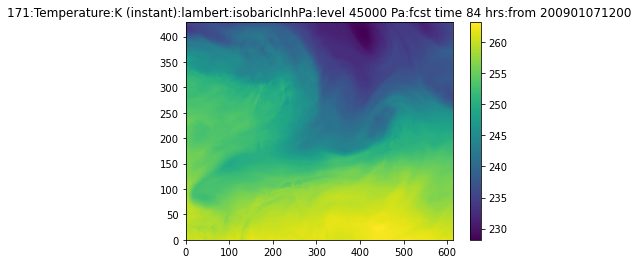

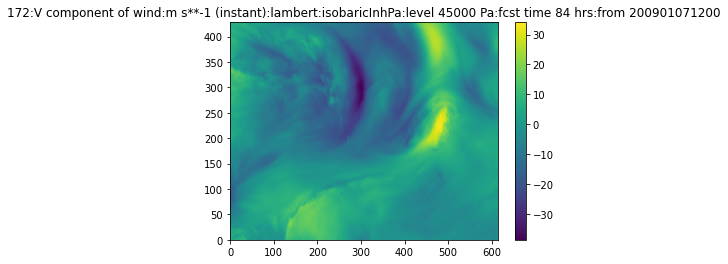

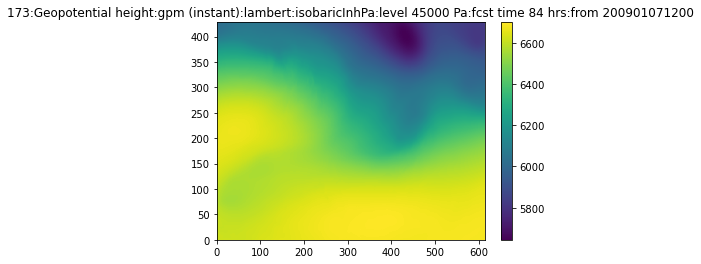

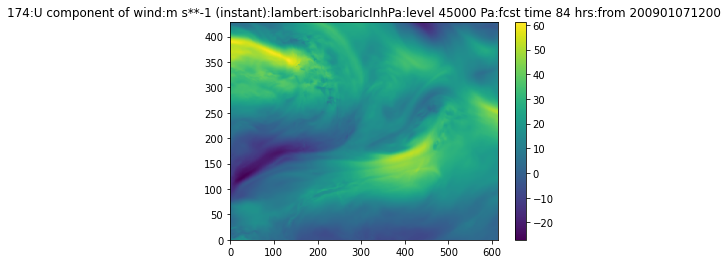

In [114]:
count = 0
for i in selected_grbs_l45000:
    plt.figure()
    grb = selected_grbs_l45000[count]
    plt.pcolormesh(grb.data()[0])
    plt.title(selected_grbs[count])
    plt.colorbar()
    count += 1
plt.show()

In [47]:
selected_grbs[2].data()[0]

array([[296.18011475, 296.18011475, 296.18011475, ..., 298.43011475,
        298.43011475, 298.43011475],
       [296.18011475, 296.05511475, 296.18011475, ..., 298.43011475,
        298.43011475, 298.43011475],
       [296.05511475, 296.05511475, 296.05511475, ..., 298.43011475,
        298.43011475, 298.43011475],
       ...,
       [272.05511475, 272.05511475, 272.05511475, ..., 275.43011475,
        275.55511475, 275.55511475],
       [271.93011475, 271.93011475, 271.93011475, ..., 275.55511475,
        275.68011475, 275.68011475],
       [271.80511475, 271.80511475, 271.80511475, ..., 275.68011475,
        275.68011475, 275.68011475]])

In [48]:
selected_grbs_l45000[2].data()[0]

array([[259.72216797, 259.72216797, 259.72216797, ..., 261.72216797,
        261.72216797, 261.72216797],
       [259.84716797, 259.72216797, 259.72216797, ..., 261.72216797,
        261.72216797, 261.72216797],
       [259.84716797, 259.84716797, 259.84716797, ..., 261.59716797,
        261.72216797, 261.72216797],
       ...,
       [236.72216797, 236.84716797, 236.84716797, ..., 240.84716797,
        240.72216797, 240.72216797],
       [236.72216797, 236.72216797, 236.72216797, ..., 240.84716797,
        240.84716797, 240.72216797],
       [236.59716797, 236.72216797, 236.72216797, ..., 240.84716797,
        240.97216797, 240.84716797]])

In [52]:
grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','level')
selected_grbs_l0=grbindx(level = 0)

In [53]:
selected_grbs_l0

[1:MSLP (Eta model reduction):Pa (instant):lambert:meanSea:level 0:fcst time 0 hrs:from 200901071200,
 2:Pressure reduced to MSL:Pa (instant):lambert:meanSea:level 0:fcst time 0 hrs:from 200901071200,
 3:Surface pressure:Pa (instant):lambert:surface:level 0:fcst time 0 hrs:from 200901071200,
 4:Categorical snow:(Code table 4.222) (instant):lambert:surface:level 0:fcst time 0 hrs:from 200901071200,
 5:Relative humidity:% (instant):lambert:sigmaLayer:levels 0.33-1.0 sigma value:fcst time 0 hrs:from 200901071200,
 6:Geopotential height:gpm (instant):lambert:isothermZero:level 0:fcst time 0 hrs:from 200901071200,
 7:Categorical ice pellets:(Code table 4.222) (instant):lambert:surface:level 0:fcst time 0 hrs:from 200901071200,
 8:U component of wind:m s**-1 (instant):lambert:tropopause:level 0:fcst time 0 hrs:from 200901071200,
 9:Categorical rain:(Code table 4.222) (instant):lambert:surface:level 0:fcst time 0 hrs:from 200901071200,
 10:Convective available potential energy:J kg**-1 (insta

616:U component of wind:m s**-1 (instant):lambert:maxWind:level 0:fcst time 66 hrs:from 200901071200


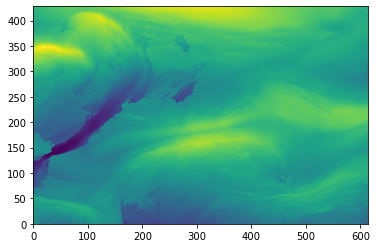

In [91]:
plt.pcolormesh(selected_grbs_l0[615].data()[0])
print(selected_grbs_l0[615])

617:U component of wind:m s**-1 (instant):lambert:tropopause:level 0:fcst time 66 hrs:from 200901071200


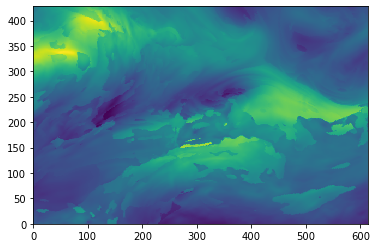

In [94]:
plt.pcolormesh(selected_grbs_l0[616].data()[0])
print(selected_grbs_l0[616])

746:Snow depth:m (instant):lambert:surface:level 0:fcst time 81 hrs:from 200901071200


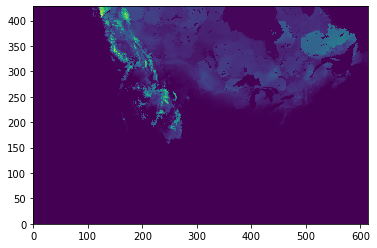

In [55]:
plt.pcolormesh(selected_grbs_l0[745].data()[0])
print(selected_grbs_l0[745])

636:Pressure:Pa (instant):lambert:maxWind:level 0:fcst time 69 hrs:from 200901071200


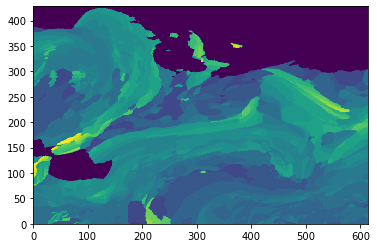

In [56]:
plt.pcolormesh(selected_grbs_l0[635].data()[0])
print(selected_grbs_l0[635])

5:Vertical velocity:Pa s**-1 (instant):lambert:isobaricInhPa:level 40000 Pa:fcst time 0 hrs:from 200901071200


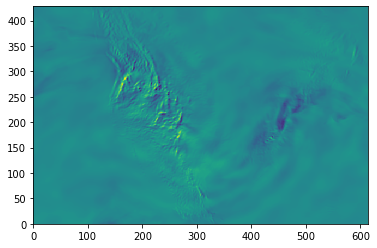

In [128]:
plt.pcolormesh(vertical_v[3].data()[0])
print(vertical_v[3])

In [109]:
grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','typeOfLevel')
selected_grbs_tropopause=grbindx(typeOfLevel = 'tropopause')

In [131]:
str(selected_grbs_tropopause[0]).split(':')

['1',
 'U component of wind',
 'm s**-1 (instant)',
 'lambert',
 'tropopause',
 'level 0',
 'fcst time 0 hrs',
 'from 200901071200']

In [110]:
selected_grbs_tropopause

[1:U component of wind:m s**-1 (instant):lambert:tropopause:level 0:fcst time 0 hrs:from 200901071200,
 2:Tropopause pressure:Pa (instant):lambert:tropopause:level 0:fcst time 0 hrs:from 200901071200,
 3:Temperature:K (instant):lambert:tropopause:level 0:fcst time 0 hrs:from 200901071200,
 4:V component of wind:m s**-1 (instant):lambert:tropopause:level 0:fcst time 0 hrs:from 200901071200,
 5:Tropopause pressure:Pa (instant):lambert:tropopause:level 0:fcst time 3 hrs:from 200901071200,
 6:U component of wind:m s**-1 (instant):lambert:tropopause:level 0:fcst time 3 hrs:from 200901071200,
 7:Temperature:K (instant):lambert:tropopause:level 0:fcst time 3 hrs:from 200901071200,
 8:V component of wind:m s**-1 (instant):lambert:tropopause:level 0:fcst time 3 hrs:from 200901071200,
 9:Tropopause pressure:Pa (instant):lambert:tropopause:level 0:fcst time 6 hrs:from 200901071200,
 10:U component of wind:m s**-1 (instant):lambert:tropopause:level 0:fcst time 6 hrs:from 200901071200,
 11:Temperat

/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figur

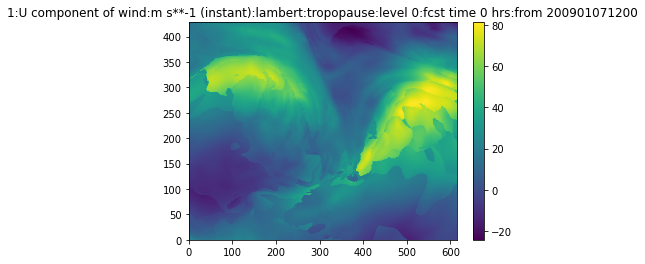

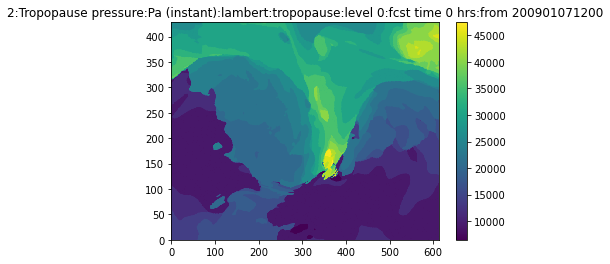

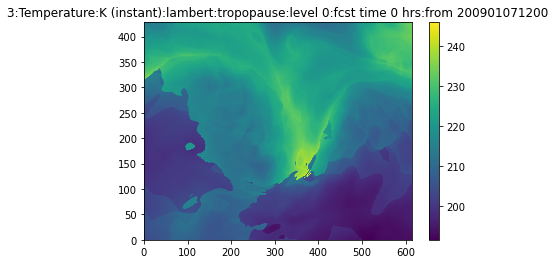

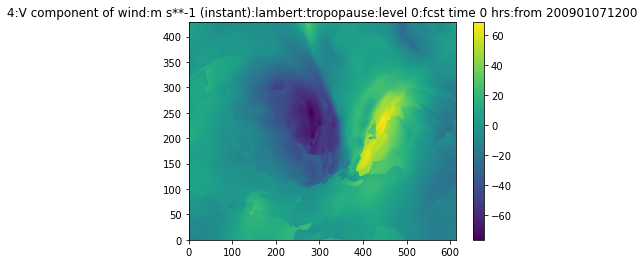

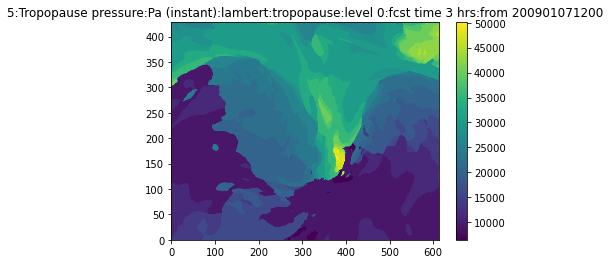

...

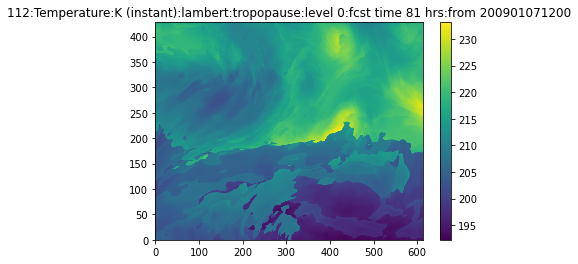

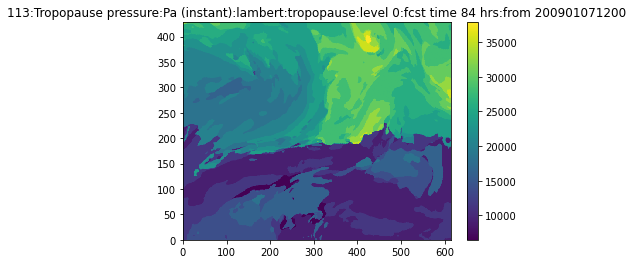

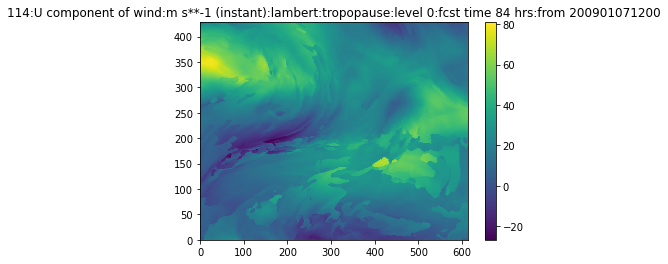

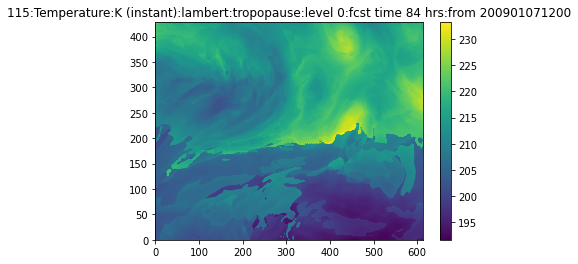

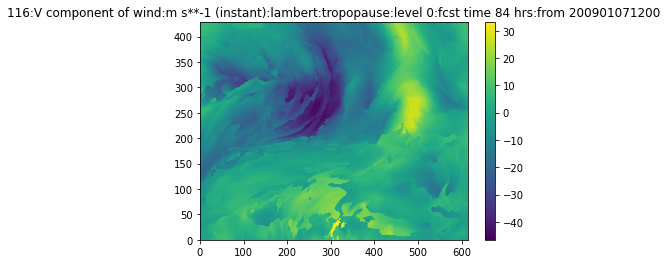

In [124]:
count = 0
for i in selected_grbs_tropopause:
    plt.figure()
    grb = selected_grbs_tropopause[count]
    plt.pcolormesh(grb.data()[0])
    plt.title(selected_grbs_tropopause[count])
    plt.colorbar()
    count += 1
plt.show()

In [122]:
grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','typeOfLevel')
selected_grbs_isotherm0=grbindx(typeOfLevel = 'isothermZero')

In [123]:
selected_grbs_isotherm0

[1:Geopotential height:gpm (instant):lambert:isothermZero:level 0:fcst time 0 hrs:from 200901071200,
 2:Relative humidity:% (instant):lambert:isothermZero:level 0:fcst time 0 hrs:from 200901071200,
 3:Geopotential height:gpm (instant):lambert:isothermZero:level 0:fcst time 3 hrs:from 200901071200,
 4:Relative humidity:% (instant):lambert:isothermZero:level 0:fcst time 3 hrs:from 200901071200,
 5:Relative humidity:% (instant):lambert:isothermZero:level 0:fcst time 6 hrs:from 200901071200,
 6:Geopotential height:gpm (instant):lambert:isothermZero:level 0:fcst time 6 hrs:from 200901071200,
 7:Geopotential height:gpm (instant):lambert:isothermZero:level 0:fcst time 9 hrs:from 200901071200,
 8:Relative humidity:% (instant):lambert:isothermZero:level 0:fcst time 9 hrs:from 200901071200,
 9:Geopotential height:gpm (instant):lambert:isothermZero:level 0:fcst time 12 hrs:from 200901071200,
 10:Relative humidity:% (instant):lambert:isothermZero:level 0:fcst time 12 hrs:from 200901071200,
 11:Geo

['heightAboveGround', 'isobaricInhPa', 'meanSea', 'surface',
       'pressureFromGroundLayer', 'sigmaLayer', 'isothermZero',
       'heightAboveGroundLayer', 'tropopause', 'atmosphereSingleLayer',
       'isobaricLayer', 'maxWind', 'hybrid']
       
[heightAboveGround, isobaricInhPa, meanSea, surface,
       pressureFromGroundLayer, sigmaLayer, isothermZero,
       heightAboveGroundLayer, tropopause, atmosphereSingleLayer,
       isobaricLayer, maxWind, hybrid]

In [11]:
grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','typeOfLevel')
heightAboveGround=grbindx(typeOfLevel='heightAboveGround')

grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','typeOfLevel')
isobaricInhPa=grbindx(typeOfLevel='isobaricInhPa')

grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','typeOfLevel')
meanSea=grbindx(typeOfLevel='meanSea')

grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','typeOfLevel')
surface=grbindx(typeOfLevel='surface')

grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','typeOfLevel')
pressureFromGroundLayer=grbindx(typeOfLevel='pressureFromGroundLayer')

grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','typeOfLevel')
sigmaLayer=grbindx(typeOfLevel='sigmaLayer')

grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','typeOfLevel')
isothermZero=grbindx(typeOfLevel='isothermZero')

grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','typeOfLevel')
heightAboveGroundLayer=grbindx(typeOfLevel='heightAboveGroundLayer')

grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','typeOfLevel')
tropopause=grbindx(typeOfLevel='tropopause')

grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','typeOfLevel')
atmosphereSingleLayer=grbindx(typeOfLevel='atmosphereSingleLayer')

grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','typeOfLevel')
isobaricLayer=grbindx(typeOfLevel='isobaricLayer')

grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','typeOfLevel')
maxWind=grbindx(typeOfLevel='maxWind')

grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','typeOfLevel')
hybrid=grbindx(typeOfLevel='hybrid')


In [12]:
a = 'heightAboveGround'
vars()[a] = heightAboveGround
b = 'isobaricInhPa'
vars()[b] = isobaricInhPa
c = 'meanSea'
vars()[c] = meanSea
d = 'surface'
vars()[d] = surface
e = 'pressureFromGroundLayer'
vars()[e] = pressureFromGroundLayer
f = 'sigmaLayer'
vars()[f] = sigmaLayer
g = 'isothermZero'
vars()[g] = isothermZero
h = 'heightAboveGroundLayer'
vars()[h] = heightAboveGroundLayer
i = 'tropopause'
vars()[i] = tropopause
j = 'atmosphereSingleLayer'
vars()[j] = atmosphereSingleLayer
k = 'isobaricLayer'
vars()[k] = isobaricLayer
l = 'maxWind'
vars()[l] = maxWind
m = 'hybrid'
vars()[m] = hybrid
layerType = ipywidgets.Dropdown(options=[heightAboveGround, isobaricInhPa, meanSea, surface,
       pressureFromGroundLayer, sigmaLayer, isothermZero,
       heightAboveGroundLayer, tropopause, atmosphereSingleLayer,
       isobaricLayer, maxWind, hybrid],
    description='Type of Layer:',layout={'width': 'max-content'})

In [13]:
layerType

Dropdown(description='Type of Layer:', layout=Layout(width='max-content'), options=([1:2 metre relative humidi…

In [15]:
layerTypes = ipywidgets.Dropdown(options=['heightAboveGround', 'isobaricInhPa', 'meanSea', 'surface', 'pressureFromGroundLayer', 'sigmaLayer', 'isothermZero', 'heightAboveGroundLayer', 'tropopause', 'atmosphereSingleLayer', 'isobaricLayer', 'maxWind', 'hybrid'],
    description='Type of Layer:',layout={'width': 'max-content'})



In [19]:
levels = [2, 200, 250, 300, 400, 550, 0, 100, 150, 350, 10, 675, 775, 450, 575, 500, 850, 625, 1000, 750, 975, 825, 950, 925, 525, 650, 700, 900, 725, 800, 600, 875, 3000, 9000, 12000, 15000, 18000, 6000, 1]
levels.sort()
print(levels)

[0, 1, 2, 10, 100, 150, 200, 250, 300, 350, 400, 450, 500, 525, 550, 575, 600, 625, 650, 675, 700, 725, 750, 775, 800, 825, 850, 875, 900, 925, 950, 975, 1000, 3000, 6000, 9000, 12000, 15000, 18000]


In [20]:
level_num = ipywidgets.SelectionSlider(options = levels,
                                       description = 'Level:', value = 0)
level_num

SelectionSlider(description='Level:', options=(0, 1, 2, 10, 100, 150, 200, 250, 300, 350, 400, 450, 500, 525, …

In [21]:
@ipywidgets.interact(layerType = layerTypes, level = level_num)
def make_plot(layerType):
    grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','typeOfLevel')
    Layer=grbindx(typeOfLevel=str(layerTypes.value))
    print(layerTypes.value)

interactive(children=(Dropdown(description='Type of Layer:', layout=Layout(width='max-content'), options=('hei…

# After working on Hurricane Sandy Data

In [2]:
import yt
import netCDF4 as nc
import pyart
import matplotlib.pyplot as plt
import pygrib
import pandas as pd
import xarray as xr
import cfgrib
import ipywidgets
import numpy as np
import os
import traitlets
import io

In [6]:
# assign directory
directory = 'data/Boulder_Fire_Event/Model_Output/'
boulder_files = []
# iterate over files in
# that directory
for filename in os.listdir(directory):
    f = os.path.join(directory, filename)
    # checking if it is a file
    if os.path.isfile(f):
        boulder_files.append(f)

In [7]:
boulder_files.sort()
boulder_files

['data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_0000.grib2',
 'data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_0600.grib2',
 'data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2',
 'data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2.923a8.idx',
 'data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1800.grib2',
 'data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090108_0000.grib2',
 'data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090108_0600.grib2',
 'data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090108_1200.grib2',
 'data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090108_1800.grib2']

In [8]:
file_dd = ipywidgets.Dropdown(options = boulder_files)
file_dd

Dropdown(options=('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_0000.grib2', 'data/Boulder_Fire_Ev…

In [9]:
forecastTimes = ipywidgets.SelectionSlider(options = [0, 3, 6, 9, 12, 15, 18, 21, 24, 27, 30, 33, 36, 39, 42, 45, 48, 51, 54, 57, 60, 63, 66, 69, 72, 75, 78, 81, 84],
                                           description = "Forecast Time:", value = 0)
forecastTimes                         

SelectionSlider(description='Forecast Time:', options=(0, 3, 6, 9, 12, 15, 18, 21, 24, 27, 30, 33, 36, 39, 42,…

In [3]:
conus = pygrib.open('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2')
conus.seek(0)
grib_cols = ['messagenumber', 'name', 'units','gridType','typeOfLevel','level','forecastTime']
grib_key_df = pd.DataFrame([[getattr(grib,key) for key in grib_cols] for grib in conus], columns = grib_cols)
grib_key_df.set_index('messagenumber')

,name,units,gridType,typeOfLevel,level,forecastTime
messagenumber,,,,,,
1,2 metre relative humidity,%,lambert,heightAboveGround,2,0
2,Vertical velocity,Pa s**-1,lambert,isobaricInhPa,200,0
3,Vertical velocity,Pa s**-1,lambert,isobaricInhPa,250,0
4,Vertical velocity,Pa s**-1,lambert,isobaricInhPa,300,0
5,Vertical velocity,Pa s**-1,lambert,isobaricInhPa,400,0
...,...,...,...,...,...,...
7041,Maximum temperature,K,lambert,heightAboveGround,2,78
7042,Probability of 0.01 inch of precipitation (POP),%,lambert,surface,0,78
7043,10 metre wind speed,m s**-1,lambert,heightAboveGround,10,81


In [4]:
grib_key_df.loc[grib_key_df.typeOfLevel == 'heightAboveGround'].name.unique()


array(['2 metre relative humidity', '2 metre temperature',
       '10 metre V wind component', '10 metre U wind component',
       'Derived radar reflectivity', '10 metre wind direction',
       '10 metre wind speed', '2 metre dewpoint temperature',
       'Minimum temperature', 'Maximum temperature'], dtype=object)

In [45]:
# Using xarray to give me names of variables for each layerType to create linked dropdown menus (i.e. variable options change depending on chosen layerType
layers = ['heightAboveGround', 'isobaricInhPa', 'meanSea', 'surface', 'pressureFromGroundLayer', 'sigmaLayer', 'isothermZero', 'heightAboveGroundLayer', 'tropopause', 'atmosphereSingleLayer', 'isobaricLayer', 'maxWind', 'hybrid']
layers_vars = {}
for i in layers:
    ds = xr.load_dataset('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2', engine='cfgrib', filter_by_keys={'typeOfLevel': i})
    short = list(ds.data_vars)
    print(short)
    variables = []
    for var in short:
#         print(ds[var].GRIB_name)
        variables.append(ds[var].GRIB_name)
#     variables = list(grib_key_df.loc[grib_key_df.typeOfLevel == i].name.unique())

    layers_vars[i] = (variables)


Ignoring index file 'data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2.923a8.idx' incompatible with GRIB file
skipping variable: paramId==166 shortName='v10'
Traceback (most recent call last):
  File "/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/cfgrib/dataset.py", line 660, in build_dataset_components
    dict_merge(variables, coord_vars)
  File "/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/cfgrib/dataset.py", line 593, in dict_merge
    "key=%r value=%r new_value=%r" % (key, master[key], value)
cfgrib.dataset.DatasetBuildError: key present and new value is different: key='heightAboveGround' value=Variable(dimensions=(), data=2.0) new_value=Variable(dimensions=(), data=10.0)
skipping variable: paramId==165 shortName='u10'
Traceback (most recent call last):
  File "/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/cfgrib/dataset.py", line 660, in build_dataset_components
    dict_merge(variables, coord_vars)
  File "/Us

['r2', 't2m', 'd2m', 'tmin', 'tmax']


skipping variable: paramId==3041 shortName='absv'
Traceback (most recent call last):
  File "/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/cfgrib/dataset.py", line 660, in build_dataset_components
    dict_merge(variables, coord_vars)
  File "/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/cfgrib/dataset.py", line 593, in dict_merge
    "key=%r value=%r new_value=%r" % (key, master[key], value)
cfgrib.dataset.DatasetBuildError: key present and new value is different: key='isobaricInhPa' value=Variable(dimensions=('isobaricInhPa',), data=array([1000.,  975.,  950.,  925.,  900.,  875.,  850.,  825.,  800.,
        775.,  750.,  725.,  700.,  675.,  650.,  625.,  600.,  575.,
        550.,  525.,  500.,  450.,  400.,  350.,  300.,  250.,  200.,
        150.,  100.])) new_value=Variable(dimensions=('isobaricInhPa',), data=array([1000.,  850.,  700.,  500.,  250.]))
skipping variable: paramId==157 shortName='r'
Traceback (most recent call last):
  File "/Use

['w', 'v', 'gh', 't', 'u']


Ignoring index file 'data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2.923a8.idx' incompatible with GRIB file


['mslet', 'prmsl']


skipping variable: paramId==3063 shortName='acpcp'
Traceback (most recent call last):
  File "/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/cfgrib/dataset.py", line 660, in build_dataset_components
    dict_merge(variables, coord_vars)
  File "/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/cfgrib/dataset.py", line 593, in dict_merge
    "key=%r value=%r new_value=%r" % (key, master[key], value)
cfgrib.dataset.DatasetBuildError: key present and new value is different: key='step' value=Variable(dimensions=('step',), data=array([ 0.,  3.,  6.,  9., 12., 15., 18., 21., 24., 27., 30., 33., 36.,
       39., 42., 45., 48., 51., 54., 57., 60., 63., 66., 69., 72., 75.,
       78., 81., 84.])) new_value=Variable(dimensions=('step',), data=array([ 3.,  6.,  9., 12., 15., 18., 21., 24., 27., 30., 33., 36., 39.,
       42., 45., 48., 51., 54., 57., 60., 63., 66., 69., 72., 75., 78.,
       81., 84.]))
skipping variable: paramId==228228 shortName='tp'
Traceback (most

['sp', 'csnow', 'cicep', 'crain', 'cape', 'sdwe', 'cfrzr', 'cin', 'vis', 'sde', 'cpofp', 'pop', 'tstm', 'cpozp']


skipping variable: paramId==59 shortName='cape'
Traceback (most recent call last):
  File "/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/cfgrib/dataset.py", line 660, in build_dataset_components
    dict_merge(variables, coord_vars)
  File "/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/cfgrib/dataset.py", line 593, in dict_merge
    "key=%r value=%r new_value=%r" % (key, master[key], value)
cfgrib.dataset.DatasetBuildError: key present and new value is different: key='pressureFromGroundLayer' value=Variable(dimensions=('pressureFromGroundLayer',), data=array([ 3000.,  6000.,  9000., 12000., 15000.])) new_value=Variable(dimensions=(), data=18000.0)
skipping variable: paramId==3024 shortName='pli'
Traceback (most recent call last):
  File "/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/cfgrib/dataset.py", line 660, in build_dataset_components
    dict_merge(variables, coord_vars)
  File "/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/si

['r', 't', 'v', 'u']


Ignoring index file 'data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2.923a8.idx' incompatible with GRIB file


['r']


Ignoring index file 'data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2.923a8.idx' incompatible with GRIB file


['gh', 'r']


Ignoring index file 'data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2.923a8.idx' incompatible with GRIB file


['hlcy']


Ignoring index file 'data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2.923a8.idx' incompatible with GRIB file


['u', 'trpp', 't', 'v']


Ignoring index file 'data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2.923a8.idx' incompatible with GRIB file


['pwat', 'tcc', 'refc']


Ignoring index file 'data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2.923a8.idx' incompatible with GRIB file


['lftx']


Ignoring index file 'data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2.923a8.idx' incompatible with GRIB file


['v', 'u', 'pres']
['refd']


In [16]:
layers_vars.values()

dict_values([['2 metre relative humidity', '2 metre temperature', '10 metre V wind component', '10 metre U wind component', 'Derived radar reflectivity', '10 metre wind direction', '10 metre wind speed', '2 metre dewpoint temperature', 'Minimum temperature', 'Maximum temperature'], ['Vertical velocity', 'V component of wind', 'Geopotential height', 'Temperature', 'Absolute vorticity', 'U component of wind', 'Relative humidity'], ['MSLP (Eta model reduction)', 'Pressure reduced to MSL'], ['Surface pressure', 'Categorical snow', 'Categorical ice pellets', 'Categorical rain', 'Convective available potential energy', 'Water equivalent of accumulated snow depth (deprecated)', 'Categorical freezing rain', 'Convective inhibition', 'Visibility', 'Snow depth', 'Convective precipitation (water)', 'Total Precipitation', 'Percent frozen precipitation', 'Probability of 0.01 inch of precipitation (POP)', 'Thunderstorm probability', 'Probability of Freezing Precipitation'], ['Relative humidity', 'Tem

In [6]:
# levels = []

layers_vars_level={}
for i in layers_vars:
    print(i)
#     for x in layers_vars[i]:
#         print(x)
    levels = (grib_key_df.loc[grib_key_df.typeOfLevel == i].level.unique()).tolist()
    levels.sort()
    layers_vars_level[i] = (layers_vars[i],levels)
        
layers_vars_level        
# layers_vars_level['pressureFromGroundLayer'].values()

heightAboveGround
isobaricInhPa
meanSea
surface
pressureFromGroundLayer
sigmaLayer
isothermZero
heightAboveGroundLayer
tropopause
atmosphereSingleLayer
isobaricLayer
maxWind
hybrid


{'heightAboveGround': (['2 metre relative humidity',
   '2 metre temperature',
   '10 metre V wind component',
   '10 metre U wind component',
   'Derived radar reflectivity',
   '10 metre wind direction',
   '10 metre wind speed',
   '2 metre dewpoint temperature',
   'Minimum temperature',
   'Maximum temperature'],
  [2, 10, 1000]),
 'isobaricInhPa': (['Vertical velocity',
   'V component of wind',
   'Geopotential height',
   'Temperature',
   'Absolute vorticity',
   'U component of wind',
   'Relative humidity'],
  [100,
   150,
   200,
   250,
   300,
   350,
   400,
   450,
   500,
   525,
   550,
   575,
   600,
   625,
   650,
   675,
   700,
   725,
   750,
   775,
   800,
   825,
   850,
   875,
   900,
   925,
   950,
   975,
   1000]),
 'meanSea': (['MSLP (Eta model reduction)', 'Pressure reduced to MSL'], [0]),
 'surface': (['Surface pressure',
   'Categorical snow',
   'Categorical ice pellets',
   'Categorical rain',
   'Convective available potential energy',
   'Wate

In [18]:
grib_key_df.loc[grib_key_df.name == 'Vertical velocity'].loc[grib_key_df.typeOfLevel == 'isobaricInhPa'].level.unique()

array([ 200,  250,  300,  400,  550,  100,  350,  675,  775,  150,  450,
        575,  625, 1000,  750,  975,  825,  950,  925,  525,  650,  700,
        900,  850,  725,  500,  800,  600,  875])

In [19]:
layer = Dropdown(options = layers_vars_level.keys())
variables = Dropdown()

# Define a function that updates the content of y based on what we select for x
def update_vars(*args):
    variables.options = layers_vars_level[layer.value][0]
layer.observe(update_vars)

level_num = Dropdown()

def update_level(*args):
#     levels = set()
#     for v in layers_vars_level[layer.value].values():
#         levels.update(set(v))
    level_num.options = layers_vars_level[layer.value][1]
variables.observe(update_level)

In [20]:
layer

Dropdown(options=('heightAboveGround', 'isobaricInhPa', 'meanSea', 'surface', 'pressureFromGroundLayer', 'sigm…

In [21]:
variables

Dropdown(options=(), value=None)

In [22]:
level_num

Dropdown(options=(), value=None)

In [23]:
layers_vars_level['atmosphereSingleLayer'][0]

['Precipitable water',
 'Total Cloud Cover',
 'Maximum/Composite radar reflectivity']

In [24]:
plt.rcParams['figure.dpi'] = 150
grb = pygrib.open('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2')
@ipywidgets.interact(typeOfLevel = layer, var = variables,level = level_num,fcstTime = forecastTimes)
def make_plt(typeOfLevel,var,level,fcstTime):
    try:
        data,lat,lon = grb.select(level = level,name = var, typeOfLevel=typeOfLevel, forecastTime= fcstTime)[0].data()
        plt.clf()
        plt.pcolormesh(data)
        plt.title(f"{var} at {fcstTime}, level: {level}")
    except ValueError:
        print('Try a new combination of Values')

/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/ipykernel/pylab/backend_inline.py:14: DeprecationWarning: `ipykernel.pylab.backend_inline` is deprecated, directly use `matplotlib_inline.backend_inline`
  DeprecationWarning


interactive(children=(Dropdown(description='typeOfLevel', options=('heightAboveGround', 'isobaricInhPa', 'mean…

In [178]:
@ipywidgets.interact(typeOfLevel = mfh.layers, var = mfh.variables,level = mfh.levels,fcstTime = forecastTimes)
def make_plt(typeOfLevel,var,level,fcstTime):
    try:
        data,lat,lon = grb.select(level = level,name = var, typeOfLevel=typeOfLevel, forecastTime= fcstTime)[0].data()
        plt.clf()
        plt.pcolormesh(data)
        plt.title(f"{mfh.variable} at {fcstTime} hrs, {mfh.layer} level: {mfh.level}")
    except ValueError:
        print('Try a new combination of Values')

interactive(children=(Dropdown(description='typeOfLevel', options=('heightAboveGround', 'isobaricInhPa', 'mean…

In [263]:
def make_plt(mfh,fcstTime):
    try:
        data,lat,lon = grb.select(level = mfh.level,name = mfh.variable, typeOfLevel=mfh.layer, forecastTime= fcstTime)[0].data()
        plt.clf()
        plt.pcolormesh(data)
        plt.title(f"{mfh.variable} at {fcstTime}, {mfh.layer} level: {mfh.level}")
    except ValueError:
        print('Try a new combination of Values')

ValueError: no matches found

In [261]:
make_plt(mfh,forecastTimes)

Try a new combination of Values


# Traitlets

In [2]:
import yt
import netCDF4 as nc
import pyart
import matplotlib.pyplot as plt
import pygrib
import pandas as pd
import xarray as xr
import cfgrib
import ipywidgets
import numpy as np
import os
import traitlets
import io

In [3]:
conus = pygrib.open('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2')
conus.seek(0)
grib_cols = ['messagenumber', 'name', 'units','gridType','typeOfLevel','level','forecastTime']
grib_key_df = pd.DataFrame([[getattr(grib,key) for key in grib_cols] for grib in conus], columns = grib_cols)
grib_key_df.set_index('messagenumber')

,name,units,gridType,typeOfLevel,level,forecastTime
messagenumber,,,,,,
1,2 metre relative humidity,%,lambert,heightAboveGround,2,0
2,Vertical velocity,Pa s**-1,lambert,isobaricInhPa,200,0
3,Vertical velocity,Pa s**-1,lambert,isobaricInhPa,250,0
4,Vertical velocity,Pa s**-1,lambert,isobaricInhPa,300,0
5,Vertical velocity,Pa s**-1,lambert,isobaricInhPa,400,0
...,...,...,...,...,...,...
7041,Maximum temperature,K,lambert,heightAboveGround,2,78
7042,Probability of 0.01 inch of precipitation (POP),%,lambert,surface,0,78
7043,10 metre wind speed,m s**-1,lambert,heightAboveGround,10,81


In [4]:
grib_key_df.loc[grib_key_df.typeOfLevel == 'heightAboveGround'].name.unique()


array(['2 metre relative humidity', '2 metre temperature',
       '10 metre V wind component', '10 metre U wind component',
       'Derived radar reflectivity', '10 metre wind direction',
       '10 metre wind speed', '2 metre dewpoint temperature',
       'Minimum temperature', 'Maximum temperature'], dtype=object)

In [5]:
# Using xarray to give me names of variables for each layerType to create linked dropdown menus (i.e. variable options change depending on chosen layerType
layers = ['heightAboveGround', 'isobaricInhPa', 'meanSea', 'surface', 'pressureFromGroundLayer', 'sigmaLayer', 'isothermZero', 'heightAboveGroundLayer', 'tropopause', 'atmosphereSingleLayer', 'isobaricLayer', 'maxWind', 'hybrid']
layers_vars = {}
for i in layers:
    variables = list(grib_key_df.loc[grib_key_df.typeOfLevel == i].name.unique())
    variables.sort()
    layers_vars[i] = (variables)


In [6]:
layers_vars_level={}
for i in layers_vars:
    print(i)
    levels = (grib_key_df.loc[grib_key_df.typeOfLevel == i].level.unique()).tolist()
    layers_vars_level[i] = (layers_vars[i],levels)
        
layers_vars_level        
# layers_vars_level['pressureFromGroundLayer'].values()

heightAboveGround
isobaricInhPa
meanSea
surface
pressureFromGroundLayer
sigmaLayer
isothermZero
heightAboveGroundLayer
tropopause
atmosphereSingleLayer
isobaricLayer
maxWind
hybrid


{'heightAboveGround': (['10 metre U wind component',
   '10 metre V wind component',
   '10 metre wind direction',
   '10 metre wind speed',
   '2 metre dewpoint temperature',
   '2 metre relative humidity',
   '2 metre temperature',
   'Derived radar reflectivity',
   'Maximum temperature',
   'Minimum temperature'],
  [2, 10, 1000]),
 'isobaricInhPa': (['Absolute vorticity',
   'Geopotential height',
   'Relative humidity',
   'Temperature',
   'U component of wind',
   'V component of wind',
   'Vertical velocity'],
  [200,
   250,
   300,
   400,
   550,
   100,
   150,
   350,
   675,
   775,
   450,
   575,
   500,
   850,
   625,
   1000,
   750,
   975,
   825,
   950,
   925,
   525,
   650,
   700,
   900,
   725,
   800,
   600,
   875]),
 'meanSea': (['MSLP (Eta model reduction)', 'Pressure reduced to MSL'], [0]),
 'surface': (['Categorical freezing rain',
   'Categorical ice pellets',
   'Categorical rain',
   'Categorical snow',
   'Convective available potential energy',

In [7]:
grb = pygrib.open('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2')

In [8]:
plt.rcParams['figure.dpi'] = 300
class MyFileHandle(traitlets.HasTraits):
    layers = traitlets.List()
    layer = traitlets.Unicode()
    levels = traitlets.List()
    level = traitlets.CInt()
    variables = traitlets.List()
    variable = traitlets.Unicode()
    fcstTimes = traitlets.List()
    fcstTime = traitlets.CInt()
    value = traitlets.Bytes()
    
    @traitlets.observe('layer')
    def _update_layer(self, change):
        layer = change['new']
        self.levels = layers_vars_level[self.layer][1]
        self.variables = layers_vars_level[self.layer][0]
        self.level = self.levels[0]
        self.variable = self.variables[0]
    
    @traitlets.default("fcstTimes")
    def _default_fsctTimes(self):
        return [0, 3, 6, 9, 12, 15, 18, 21, 24, 27, 30, 33, 36, 39, 42, 45, 48, 51, 54, 57, 60, 63, 66, 69, 72, 75, 78, 81, 84]
    
    @traitlets.observe('layer','variable', 'level', 'fcstTime')
    def _new_plot(self, change):    
        c = io.BytesIO()
        plt.clf()
        try:
            data,lat,lon = grb.select(level = self.level,name = self.variable, typeOfLevel=self.layer, forecastTime= self.fcstTime)[0].data()
        except ValueError:
            return
        plt.pcolormesh(data)
        plt.title(f"{self.variable} at {self.fcstTime} hrs, {self.layer} level: {self.level}")
        plt.savefig(c)
        c.seek(0)
        self.value = c.read()
        plt.clf()

        
    def _ipython_display_(self):
        layers_dropdown = ipywidgets.Dropdown(options=self.layers)
        levels_dropdown = ipywidgets.Dropdown(options=self.levels)
        variables_dropdown = ipywidgets.Dropdown(options=self.variables)
#         fcstTimes_slider = ipywidgets.IntSlider(options = self.fcstTimes)
        fcstTimes_slider = ipywidgets.IntSlider(min = self.fcstTimes[0],max = self.fcstTimes[-1], step = 3)
    
        
        traitlets.link((layers_dropdown, 'options'),(self, 'layers'))
        traitlets.link((levels_dropdown, 'options'),(self, 'levels'))
        traitlets.link((variables_dropdown, 'options'),(self, 'variables'))
        traitlets.link((fcstTimes_slider, 'value'),(self, 'fcstTime'))
        

#         print(variables_dropdown.value)
#         print(self.layer)

        traitlets.link((layers_dropdown, 'value'),(self, 'layer'))
        traitlets.link((variables_dropdown, 'value'),(self, 'variable'))
        traitlets.link((levels_dropdown, 'value'), (self, 'level'))

        
        im = ipywidgets.Image(format = 'png', width=1000, height=1000)
        traitlets.link((im, 'value'), (self, 'value'))

        display(ipywidgets.VBox([layers_dropdown, variables_dropdown, levels_dropdown,fcstTimes_slider,im]))


In [9]:
mfh = MyFileHandle(layers = list(layers_vars_level.keys()))#,levels =list(layers_vars_level[layer.value])[1],variables = list(layers_vars_level[layer.value])[0],layer = layers[0],variable=variables[0],level=levels[0])


In [10]:
# plt.rcParams['figure.dpi'] = 200
mfh

<Figure size 1800x1200 with 0 Axes>

In [63]:
xarray_dict = {'heightAboveGround': (['2 metre relative humidity',
   '2 metre temperature',
   '2 metre dewpoint temperature',
   'Minimum temperature',
   'Maximum temperature'],
  [2, 10, 1000]),
 'isobaricInhPa': (['Vertical velocity',
   'V component of wind',
   'Geopotential height',
   'Temperature',
   'U component of wind'],
  [200,
   250,
   300,
   400,
   550,
   100,
   150,
   350,
   675,
   775,
   450,
   575,
   500,
   850,
   625,
   1000,
   750,
   975,
   825,
   950,
   925,
   525,
   650,
   700,
   900,
   725,
   800,
   600,
   875]),
 'meanSea': (['MSLP (Eta model reduction)', 'Pressure reduced to MSL'], [0]),
 'surface': (['Surface pressure',
   'Categorical snow',
   'Categorical ice pellets',
   'Categorical rain',
   'Convective available potential energy',
   'Water equivalent of accumulated snow depth (deprecated)',
   'Categorical freezing rain',
   'Convective inhibition',
   'Visibility',
   'Snow depth',
   'Percent frozen precipitation',
   'Probability of 0.01 inch of precipitation (POP)',
   'Thunderstorm probability',
   'Probability of Freezing Precipitation'],
  [0]),
 'pressureFromGroundLayer': (['Relative humidity',
   'Temperature',
   'V component of wind',
   'U component of wind'],
  [3000, 9000, 12000, 15000, 18000, 6000]),
 'sigmaLayer': (['Relative humidity'], [0]),
 'isothermZero': (['Geopotential height', 'Relative humidity'], [0]),
 'heightAboveGroundLayer': (['Storm relative helicity'], [3000]),
 'tropopause': (['U component of wind',
   'Tropopause pressure',
   'Temperature',
   'V component of wind'],
  [0]),
 'atmosphereSingleLayer': (['Precipitable water',
   'Total Cloud Cover',
   'Maximum/Composite radar reflectivity'],
  [0]),
 'isobaricLayer': (['Surface lifted index'], [500]),
 'maxWind': (['V component of wind', 'U component of wind', 'Pressure'], [0]),
 'hybrid': (['Derived radar reflectivity'], [1])}

In [94]:
for i in layers_vars_level:
    exclude = []
#     print(xarray_dict[i],layers_vars_level[i])
    for x in layers_vars_level[i][0]:
        exclude_dict = {}
        
        if x not in xarray_dict[i][0]:
            exclude.append(x)
#             print(exclude)
        exclude_dict[i]=exclude
    print(exclude_dict)

{'heightAboveGround': ['10 metre U wind component', '10 metre V wind component', '10 metre wind direction', '10 metre wind speed', 'Derived radar reflectivity']}
{'isobaricInhPa': ['Absolute vorticity', 'Relative humidity']}
{'meanSea': []}
{'surface': ['Convective precipitation (water)', 'Total Precipitation']}
{'pressureFromGroundLayer': ['Best (4-layer) lifted index', 'Convective available potential energy', 'Convective inhibition', 'Parcel lifted index (to 500 hPa)']}
{'sigmaLayer': []}
{'isothermZero': []}
{'heightAboveGroundLayer': []}
{'tropopause': []}
{'atmosphereSingleLayer': []}
{'isobaricLayer': []}
{'maxWind': []}
{'hybrid': []}


In [89]:
exclude_dict

{'layers_vars_level[i]': []}

In [11]:
fcst_index.

SyntaxError: invalid syntax (2586293115.py, line 1)

# yt

In [1]:
import yt
import netCDF4 as nc
import pyart
import matplotlib.pyplot as plt
import pygrib
import pandas as pd
import xarray as xr
import cfgrib
import ipywidgets
import numpy as np


## You are using the Python ARM Radar Toolkit (Py-ART), an open source
## library for working with weather radar data. Py-ART is partly
## supported by the U.S. Department of Energy as part of the Atmospheric
## Radiation Measurement (ARM) Climate Research Facility, an Office of
## Science user facility.
##
## If you use this software to prepare a publication, please cite:
##
##     JJ Helmus and SM Collis, JORS 2016, doi: 10.5334/jors.119



In [129]:
def yt_load(time,layer):
    grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','forecastTime','typeOfLevel')
    fcst_index=grbindx(forecastTime = time,typeOfLevel = layer)
    fcst_index_dict={}
    for i in fcst_index:
#         lev = str(i).split(':')[5]
#         lev = str(str(i).split(':')[5]).split(' ')[1] # Gets rid of 'level ____ Pa'
        lev = int(str(str(i).split(':')[5]).split(' ')[1])/100 
        #divide by 100 so levels are equal to the grib_key_df level values (depth)
        #Might be a problem with some levels being 9000-6000,15000-12000 etc. I think it's subtracting with int()
#        print(lev)
        var = str(i).split(':')[1]
        fcst_index_dict[int(str(i).split(':')[0])-1]=(lev,var)
    
    grib_cols = ['messagenumber', 'name', 'units','gridType','typeOfLevel','level']
    grib_key_df = pd.DataFrame([[getattr(grib,key) for key in grib_cols] for grib in fcst_index], columns = grib_cols)
    grib_key_df.set_index('messagenumber')
    
#     print(grib_key_df)
#     v_names = (grib_key_df.name.unique())
    depth = np.sort(grib_key_df.level.unique()) #shape = 29
#     print(depth,len(depth))
#     latitude = fcst_index[1].data()[1] #shape = 428,614
    latitude = new_lat #shape = 262792
    longitude = new_lon
#     longitude = fcst_index[1].data()[2]
#     print(len(fcst_index_dict))
    data = {fcst_index_dict[i]: fcst_index[i].data() for i in range(1,len(fcst_index_dict))}
#     print(data)
    bbox = np.array([[depth[0], depth[-1]],
                    [latitude[0], latitude[-1]],
                    [longitude[0],longitude[-1]]],dtype=object)
    print(bbox)
    ds = yt.load_uniform_grid(data, domain_dimensions = (depth.shape[0], latitude.shape[0], longitude.shape[0]),bbox = bbox)
    print(ds)

#         c += 1
#     ds = yt.load(fcst_index.data)
#     return(ds)

In [130]:
yt_load(0,'isobaricInhPa')

[[100 1000]
 [12.190000000000017 57.32843565459641]
 [-133.459 -49.415986585644376]]


YTInconsistentGridFieldShapeGridDims: Not all grid-based fields match the grid dimensions! Grid dims are (29, 262792, 262792), and the following fields have shapes that do not match them:
    Field (250.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (300.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (400.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (550.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (100.0, 'V component of wind') has shape (3, 428, 614).
    Field (200.0, 'Geopotential height') has shape (3, 428, 614).
    Field (150.0, 'Geopotential height') has shape (3, 428, 614).
    Field (100.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (150.0, 'V component of wind') has shape (3, 428, 614).
    Field (350.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (100.0, 'Temperature') has shape (3, 428, 614).
    Field (100.0, 'Geopotential height') has shape (3, 428, 614).
    Field (250.0, 'Absolute vorticity') has shape (3, 428, 614).
    Field (150.0, 'Temperature') has shape (3, 428, 614).
    Field (150.0, 'U component of wind') has shape (3, 428, 614).
    Field (675.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (775.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (150.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (250.0, 'V component of wind') has shape (3, 428, 614).
    Field (350.0, 'Temperature') has shape (3, 428, 614).
    Field (100.0, 'U component of wind') has shape (3, 428, 614).
    Field (450.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (300.0, 'Temperature') has shape (3, 428, 614).
    Field (575.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (500.0, 'Absolute vorticity') has shape (3, 428, 614).
    Field (850.0, 'Absolute vorticity') has shape (3, 428, 614).
    Field (625.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (1000.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (750.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (350.0, 'V component of wind') has shape (3, 428, 614).
    Field (200.0, 'Temperature') has shape (3, 428, 614).
    Field (200.0, 'U component of wind') has shape (3, 428, 614).
    Field (300.0, 'Relative humidity') has shape (3, 428, 614).
    Field (300.0, 'U component of wind') has shape (3, 428, 614).
    Field (250.0, 'U component of wind') has shape (3, 428, 614).
    Field (975.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (300.0, 'Geopotential height') has shape (3, 428, 614).
    Field (825.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (950.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (1000.0, 'Absolute vorticity') has shape (3, 428, 614).
    Field (250.0, 'Temperature') has shape (3, 428, 614).
    Field (925.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (575.0, 'Temperature') has shape (3, 428, 614).
    Field (525.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (650.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (700.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (400.0, 'Temperature') has shape (3, 428, 614).
    Field (300.0, 'V component of wind') has shape (3, 428, 614).
    Field (500.0, 'Relative humidity') has shape (3, 428, 614).
    Field (500.0, 'Geopotential height') has shape (3, 428, 614).
    Field (200.0, 'V component of wind') has shape (3, 428, 614).
    Field (525.0, 'Relative humidity') has shape (3, 428, 614).
    Field (700.0, 'Absolute vorticity') has shape (3, 428, 614).
    Field (550.0, 'U component of wind') has shape (3, 428, 614).
    Field (900.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (350.0, 'Geopotential height') has shape (3, 428, 614).
    Field (350.0, 'Relative humidity') has shape (3, 428, 614).
    Field (850.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (725.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (525.0, 'U component of wind') has shape (3, 428, 614).
    Field (500.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (250.0, 'Geopotential height') has shape (3, 428, 614).
    Field (525.0, 'V component of wind') has shape (3, 428, 614).
    Field (575.0, 'Geopotential height') has shape (3, 428, 614).
    Field (550.0, 'V component of wind') has shape (3, 428, 614).
    Field (350.0, 'U component of wind') has shape (3, 428, 614).
    Field (400.0, 'V component of wind') has shape (3, 428, 614).
    Field (800.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (600.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (875.0, 'Vertical velocity') has shape (3, 428, 614).
    Field (400.0, 'Relative humidity') has shape (3, 428, 614).
    Field (450.0, 'Temperature') has shape (3, 428, 614).
    Field (450.0, 'Geopotential height') has shape (3, 428, 614).
    Field (400.0, 'Geopotential height') has shape (3, 428, 614).
    Field (450.0, 'Relative humidity') has shape (3, 428, 614).
    Field (550.0, 'Geopotential height') has shape (3, 428, 614).
    Field (600.0, 'Relative humidity') has shape (3, 428, 614).
    Field (400.0, 'U component of wind') has shape (3, 428, 614).
    Field (575.0, 'U component of wind') has shape (3, 428, 614).
    Field (500.0, 'V component of wind') has shape (3, 428, 614).
    Field (550.0, 'Relative humidity') has shape (3, 428, 614).
    Field (575.0, 'Relative humidity') has shape (3, 428, 614).
    Field (625.0, 'Geopotential height') has shape (3, 428, 614).
    Field (525.0, 'Geopotential height') has shape (3, 428, 614).
    Field (750.0, 'Geopotential height') has shape (3, 428, 614).
    Field (650.0, 'U component of wind') has shape (3, 428, 614).
    Field (725.0, 'V component of wind') has shape (3, 428, 614).
    Field (725.0, 'U component of wind') has shape (3, 428, 614).
    Field (650.0, 'Geopotential height') has shape (3, 428, 614).
    Field (625.0, 'Temperature') has shape (3, 428, 614).
    Field (775.0, 'Temperature') has shape (3, 428, 614).
    Field (725.0, 'Geopotential height') has shape (3, 428, 614).
    Field (675.0, 'Temperature') has shape (3, 428, 614).
    Field (650.0, 'V component of wind') has shape (3, 428, 614).
    Field (625.0, 'Relative humidity') has shape (3, 428, 614).
    Field (650.0, 'Temperature') has shape (3, 428, 614).
    Field (675.0, 'Relative humidity') has shape (3, 428, 614).
    Field (750.0, 'Temperature') has shape (3, 428, 614).
    Field (575.0, 'V component of wind') has shape (3, 428, 614).
    Field (675.0, 'U component of wind') has shape (3, 428, 614).
    Field (750.0, 'U component of wind') has shape (3, 428, 614).
    Field (700.0, 'V component of wind') has shape (3, 428, 614).
    Field (625.0, 'V component of wind') has shape (3, 428, 614).
    Field (700.0, 'Geopotential height') has shape (3, 428, 614).
    Field (725.0, 'Temperature') has shape (3, 428, 614).
    Field (675.0, 'V component of wind') has shape (3, 428, 614).
    Field (825.0, 'Geopotential height') has shape (3, 428, 614).
    Field (700.0, 'Relative humidity') has shape (3, 428, 614).
    Field (750.0, 'Relative humidity') has shape (3, 428, 614).
    Field (600.0, 'Temperature') has shape (3, 428, 614).
    Field (725.0, 'Relative humidity') has shape (3, 428, 614).
    Field (700.0, 'U component of wind') has shape (3, 428, 614).
    Field (675.0, 'Geopotential height') has shape (3, 428, 614).
    Field (700.0, 'Temperature') has shape (3, 428, 614).
    Field (800.0, 'Temperature') has shape (3, 428, 614).
    Field (775.0, 'V component of wind') has shape (3, 428, 614).
    Field (875.0, 'Relative humidity') has shape (3, 428, 614).
    Field (850.0, 'U component of wind') has shape (3, 428, 614).
    Field (650.0, 'Relative humidity') has shape (3, 428, 614).
    Field (875.0, 'U component of wind') has shape (3, 428, 614).
    Field (775.0, 'Relative humidity') has shape (3, 428, 614).
    Field (850.0, 'V component of wind') has shape (3, 428, 614).
    Field (900.0, 'Temperature') has shape (3, 428, 614).
    Field (900.0, 'Relative humidity') has shape (3, 428, 614).
    Field (825.0, 'U component of wind') has shape (3, 428, 614).
    Field (775.0, 'Geopotential height') has shape (3, 428, 614).
    Field (875.0, 'Temperature') has shape (3, 428, 614).
    Field (900.0, 'U component of wind') has shape (3, 428, 614).
    Field (1000.0, 'Temperature') has shape (3, 428, 614).
    Field (875.0, 'V component of wind') has shape (3, 428, 614).
    Field (900.0, 'Geopotential height') has shape (3, 428, 614).
    Field (875.0, 'Geopotential height') has shape (3, 428, 614).
    Field (800.0, 'Relative humidity') has shape (3, 428, 614).
    Field (825.0, 'Temperature') has shape (3, 428, 614).
    Field (825.0, 'V component of wind') has shape (3, 428, 614).
    Field (850.0, 'Geopotential height') has shape (3, 428, 614).
    Field (850.0, 'Relative humidity') has shape (3, 428, 614).
    Field (800.0, 'U component of wind') has shape (3, 428, 614).
    Field (800.0, 'V component of wind') has shape (3, 428, 614).
    Field (800.0, 'Geopotential height') has shape (3, 428, 614).
    Field (825.0, 'Relative humidity') has shape (3, 428, 614).
    Field (775.0, 'U component of wind') has shape (3, 428, 614).
    Field (750.0, 'V component of wind') has shape (3, 428, 614).
    Field (850.0, 'Temperature') has shape (3, 428, 614).
    Field (925.0, 'Temperature') has shape (3, 428, 614).
    Field (1000.0, 'Geopotential height') has shape (3, 428, 614).
    Field (950.0, 'Relative humidity') has shape (3, 428, 614).
    Field (925.0, 'Geopotential height') has shape (3, 428, 614).
    Field (900.0, 'V component of wind') has shape (3, 428, 614).
    Field (1000.0, 'Relative humidity') has shape (3, 428, 614).
    Field (925.0, 'V component of wind') has shape (3, 428, 614).
    Field (975.0, 'V component of wind') has shape (3, 428, 614).
    Field (975.0, 'U component of wind') has shape (3, 428, 614).
    Field (975.0, 'Relative humidity') has shape (3, 428, 614).
    Field (950.0, 'Temperature') has shape (3, 428, 614).
    Field (925.0, 'U component of wind') has shape (3, 428, 614).
    Field (950.0, 'Geopotential height') has shape (3, 428, 614).
    Field (1000.0, 'U component of wind') has shape (3, 428, 614).
    Field (925.0, 'Relative humidity') has shape (3, 428, 614).
    Field (950.0, 'U component of wind') has shape (3, 428, 614).
    Field (1000.0, 'V component of wind') has shape (3, 428, 614).
    Field (950.0, 'V component of wind') has shape (3, 428, 614).
    Field (975.0, 'Temperature') has shape (3, 428, 614).
    Field (975.0, 'Geopotential height') has shape (3, 428, 614).
    Field (450.0, 'U component of wind') has shape (3, 428, 614).
    Field (600.0, 'U component of wind') has shape (3, 428, 614).
    Field (500.0, 'Temperature') has shape (3, 428, 614).
    Field (525.0, 'Temperature') has shape (3, 428, 614).
    Field (450.0, 'V component of wind') has shape (3, 428, 614).
    Field (500.0, 'U component of wind') has shape (3, 428, 614).
    Field (625.0, 'U component of wind') has shape (3, 428, 614).
    Field (600.0, 'V component of wind') has shape (3, 428, 614).
    Field (550.0, 'Temperature') has shape (3, 428, 614).
    Field (600.0, 'Geopotential height') has shape (3, 428, 614).


In [313]:
for variable in variables:
    data[variable] = np.stack([variables[variable][level] for level in sorted(variables[variable])], axis = -1)
    

In [153]:
data['Temperature'].shape

(428, 614, 29)

In [338]:
from natsort import index_natsorted
def yt_load(time,layer):
    grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','forecastTime','typeOfLevel')
    fcst_index=grbindx(forecastTime = time,typeOfLevel = layer)

    grib_cols = ['messagenumber', 'name', 'units','gridType','typeOfLevel','level']
    grib_key_df = pd.DataFrame([[getattr(grib,key) for key in grib_cols] for grib in fcst_index], columns = grib_cols)
    grib_key_df.set_index('messagenumber')
    
    fcst_index_dict={}
    for i in fcst_index:
        lev = int(str(str(i).split(':')[5]).split(' ')[1])/100 
        var = str(i).split(':')[1]
        fcst_index_dict[int(str(i).split(':')[0])-1]=(lev,var)
    
    variables = {x: {} for x in set(c[1] for c in fcst_index_dict.values()) }

    data = {}
    for ind, (level, var) in fcst_index_dict.items():
        variables[var][int(level)] = fcst_index[ind].data()[0]

    for variable in variables:
#         data[variable] = np.stack([variables[variable][level] for level in (variables[variable])], axis = -1)
        data[variable] = np.stack([variables[variable][level] for level in sorted(variables[variable])], axis = -1)


    latitude = fcst_index[11].data()[1]
    longitude = fcst_index[11].data()[2]
    depth = np.sort(grib_key_df.level.unique())

#     depth = grib_key_df.level.unique()

    bbox = np.array([[latitude.min(), latitude.max()],
                    [longitude.min(),longitude.max()],
                     [depth.min(), depth.max()]],dtype='f8')
    print(bbox)
    data.pop('Absolute vorticity')
    data.pop('Relative humidity')
    ds = yt.load_uniform_grid(data, domain_dimensions = (428, 614, 29),bbox = bbox,
                        geometry = ('geographic'))
    return ds

In [339]:
iso_12 = yt_load(12,'isobaricInhPa')

yt : [INFO     ] 2022-06-23 12:00:19,739 Parameters: current_time              = 0.0
yt : [INFO     ] 2022-06-23 12:00:19,739 Parameters: domain_dimensions         = [428 614  29]
yt : [INFO     ] 2022-06-23 12:00:19,740 Parameters: domain_left_edge          = [  12.19      -152.8786225  100.       ]
yt : [INFO     ] 2022-06-23 12:00:19,740 Parameters: domain_right_edge         = [  61.30935757  -49.41598659 1000.        ]
yt : [INFO     ] 2022-06-23 12:00:19,740 Parameters: cosmological_simulation   = 0


[[  12.19         61.30935757]
 [-152.8786225   -49.41598659]
 [ 100.         1000.        ]]


yt : [INFO     ] 2022-06-23 12:00:19,844 Setting origin='native' for geographic geometry.
yt : [INFO     ] 2022-06-23 12:00:19,853 xlim = 100.000000 1000.000000
yt : [INFO     ] 2022-06-23 12:00:19,853 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-23 12:00:19,855 xlim = 100.000000 1000.000000
yt : [INFO     ] 2022-06-23 12:00:19,855 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-23 12:00:19,856 Making a fixed resolution buffer of (('stream', 'U component of wind')) 800 by 800
yt : [WARNING  ] 2022-06-23 12:00:19,882 Plotting ('stream', 'U component of wind'): Both positive and negative values. Min = -10.940109252929688 dimensionless, Max = 44.427852630615234 dimensionless.
yt : [WARNING  ] 2022-06-23 12:00:19,883 Switching to symlog colorbar scaling.



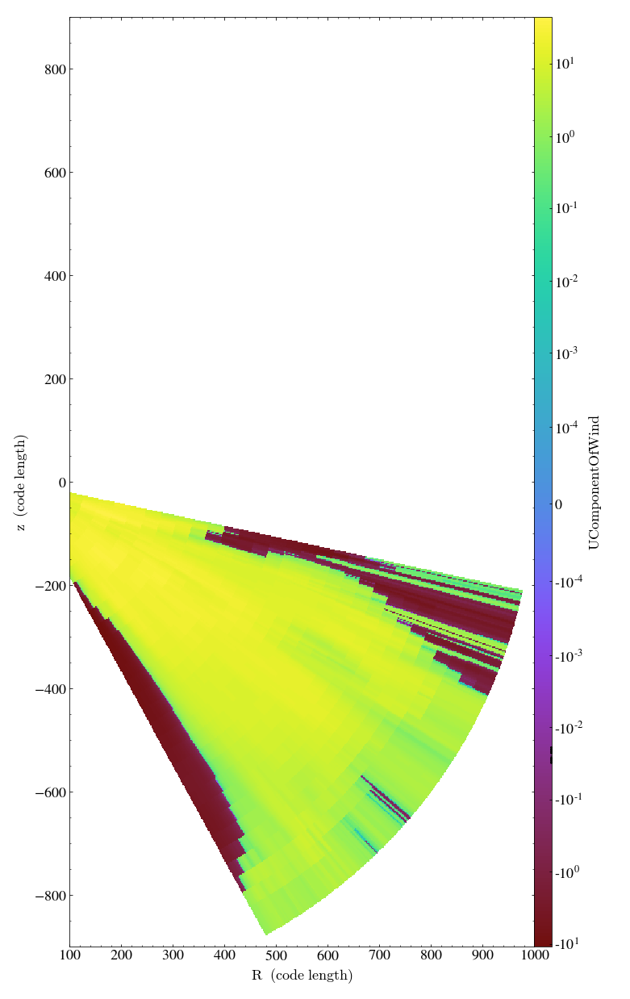

In [340]:
yt.SlicePlot(iso_12,'longitude','U component of wind')

yt : [INFO     ] 2022-06-22 12:16:46,426 Setting origin='native' for internal_geographic geometry.
yt : [INFO     ] 2022-06-22 12:16:46,437 xlim = -900.000000 900.000000
yt : [INFO     ] 2022-06-22 12:16:46,438 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-22 12:16:46,439 xlim = -900.000000 900.000000
yt : [INFO     ] 2022-06-22 12:16:46,439 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-22 12:16:46,440 Making a fixed resolution buffer of (('stream', 'U component of wind')) 800 by 800
yt : [WARNING  ] 2022-06-22 12:16:46,472 Plotting ('stream', 'U component of wind'): Both positive and negative values. Min = -36.891510009765625 dimensionless, Max = 14001.6640625 dimensionless.
yt : [WARNING  ] 2022-06-22 12:16:46,472 Switching to symlog colorbar scaling.



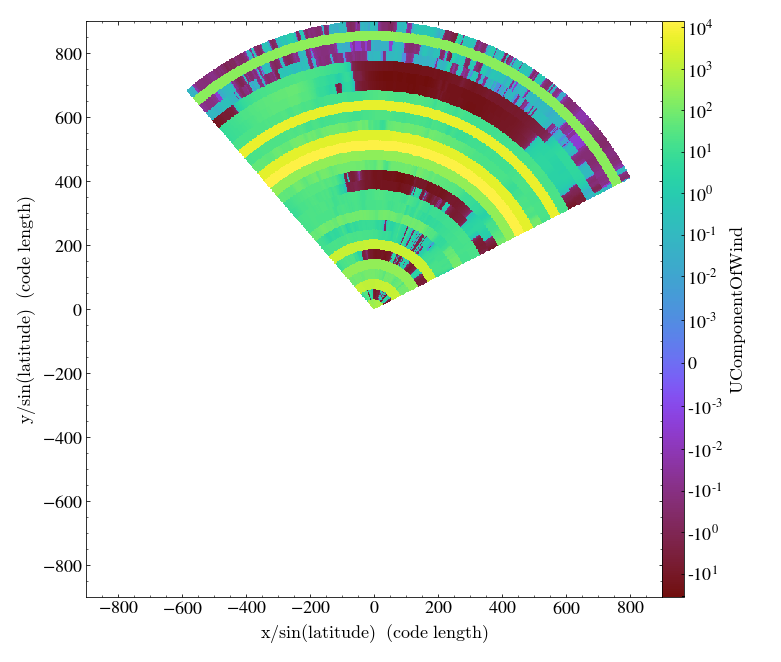

In [229]:
yt.SlicePlot(iso_12,'latitude','U component of wind')

In [218]:
iso_84 = yt_load(84,'isobaricInhPa')

yt : [INFO     ] 2022-06-22 11:22:48,285 Parameters: current_time              = 0.0
yt : [INFO     ] 2022-06-22 11:22:48,286 Parameters: domain_dimensions         = [428 614  29]
yt : [INFO     ] 2022-06-22 11:22:48,286 Parameters: domain_left_edge          = [  12.19      -152.8786225  100.       ]
yt : [INFO     ] 2022-06-22 11:22:48,287 Parameters: domain_right_edge         = [  61.30935757  -49.41598659 1000.        ]
yt : [INFO     ] 2022-06-22 11:22:48,287 Parameters: cosmological_simulation   = 0


yt : [INFO     ] 2022-06-22 11:24:16,490 Setting origin='native' for internal_geographic geometry.
yt : [INFO     ] 2022-06-22 11:24:16,515 xlim = -900.000000 900.000000
yt : [INFO     ] 2022-06-22 11:24:16,515 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-22 11:24:16,517 xlim = -900.000000 900.000000
yt : [INFO     ] 2022-06-22 11:24:16,518 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-22 11:24:16,520 Making a fixed resolution buffer of (('stream', 'U component of wind')) 800 by 800
yt : [WARNING  ] 2022-06-22 11:24:16,563 Plotting ('stream', 'U component of wind'): Both positive and negative values. Min = -25.180511474609375 dimensionless, Max = 16437.94921875 dimensionless.
yt : [WARNING  ] 2022-06-22 11:24:16,563 Switching to symlog colorbar scaling.



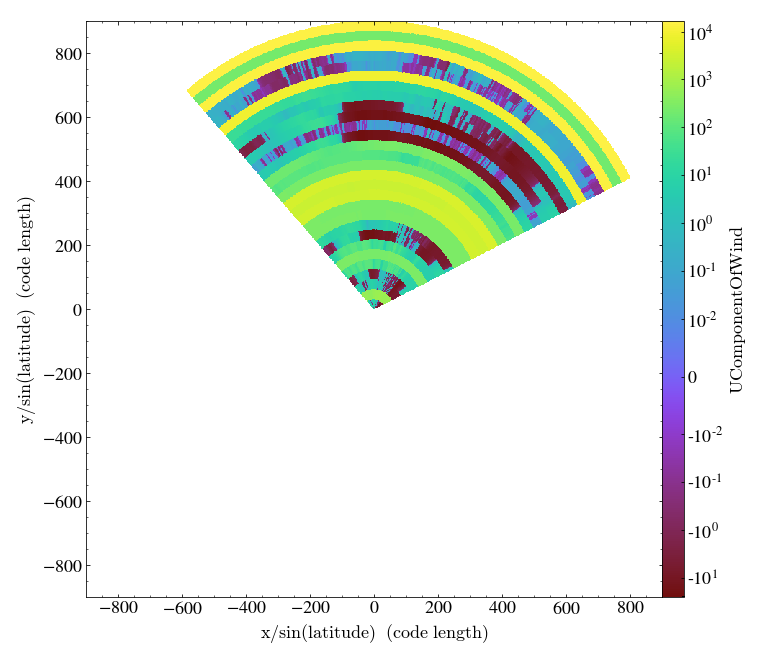

In [219]:
yt.SlicePlot(iso_84,'latitude','U component of wind')

In [253]:
grib_cols = ['messagenumber', 'name', 'units','gridType','typeOfLevel','level']
grib_key_df = pd.DataFrame([[getattr(grib,key) for key in grib_cols] for grib in fcst_index], columns = grib_cols)
grib_key_df.set_index('messagenumber')
from natsort import index_natsorted
grib_key_df=grib_key_df.sort_values(
   by="level",
   key=lambda x: np.argsort(index_natsorted(grib_key_df["level"])))
grib_key_df

,messagenumber,name,units,gridType,typeOfLevel,level
5,6,V component of wind,m s**-1,lambert,isobaricInhPa,100
8,9,Vertical velocity,Pa s**-1,lambert,isobaricInhPa,100
11,12,Temperature,K,lambert,isobaricInhPa,100
12,13,Geopotential height,gpm,lambert,isobaricInhPa,100
21,22,U component of wind,m s**-1,lambert,isobaricInhPa,100
...,...,...,...,...,...,...
129,130,Temperature,K,lambert,isobaricInhPa,1000
146,147,Geopotential height,gpm,lambert,isobaricInhPa,1000
150,151,Relative humidity,%,lambert,isobaricInhPa,1000
158,159,U component of wind,m s**-1,lambert,isobaricInhPa,1000


In [310]:
fcst_index_dict={}
for index,row in grib_key_df.iterrows():
#     print(row.messagenumber)
#         lev = int(str(str(i).split(':')[5]).split(' ')[1])/100 
#         var = str(i).split(':')[1]
#         fcst_index_dict[int(str(i).split(':')[0])-1]=(lev,var)
    lev = str(grib_key_df.loc[grib_key_df['messagenumber']==row.messagenumber].level).split('\n')[0]
    print(lev)
    lev = str(lev).split('    ')[1]
    var = str(grib_key_df.loc[grib_key_df['messagenumber']==row.messagenumber].name).split('\n')[0]
    var = str(var).split('    ')[1]
    print(lev,var)

    fcst_index_dict[(row.messagenumber)-1]=(lev,var)
    
print(fcst_index_dict)

5    100
100 V component of wind
8    100
100 Vertical velocity
11    100
100 Temperature
12    100
100 Geopotential height
21    100
100 U component of wind
7    150
150 Geopotential height
9    150
150 V component of wind
14    150
150 Temperature
15    150
150 U component of wind
18    150
150 Vertical velocity
0    200
200 Vertical velocity
6    200
200 Geopotential height
31    200
200 Temperature
32    200
200 U component of wind
51    200
200 V component of wind
1    250
250 Vertical velocity
13    250
250 Absolute vorticity
19    250
250 V component of wind
35    250
250 U component of wind
41    250
250 Temperature
62    250
250 Geopotential height
2    300
300 Vertical velocity
23    300
300 Temperature
33    300
300 Relative humidity
34    300
300 U component of wind
37    300
300 Geopotential height
48    300
300 V component of wind
10    350
350 Vertical velocity
20    350
350 Temperature
30    350
350 V component of wind
56    350
350 Geopotential height
57    350
350 Rel

In [311]:
variables = {x: {} for x in set(c[1] for c in fcst_index_dict.values()) }
variables

{'U component of wind': {},
 'Absolute vorticity': {},
 'Temperature': {},
 'V component of wind': {},
 'Geopotential height': {},
 'Relative humidity': {},
 'Vertical velocity': {}}

In [312]:
data = {}
for ind, (level, var) in fcst_index_dict.items():
    variables[var][int(level)] = fcst_index[ind].data()[0]
variables

{'U component of wind': {100: array([[13.54683876, 13.42183876, 13.29683876, ...,  1.29683876,
           1.17183876,  1.17183876],
         [13.29683876, 13.17183876, 13.04683876, ...,  1.17183876,
           1.17183876,  1.17183876],
         [13.04683876, 12.92183876, 12.79683876, ...,  1.17183876,
           1.17183876,  1.17183876],
         ...,
         [27.04683876, 27.17183876, 27.29683876, ..., 11.42183876,
          11.29683876, 11.17183876],
         [26.92183876, 27.04683876, 27.17183876, ..., 11.29683876,
          11.29683876, 11.17183876],
         [26.79683876, 26.92183876, 27.04683876, ..., 11.29683876,
          11.17183876, 11.04683876]]),
  150: array([[28.6668129, 28.2918129, 27.9168129, ..., 14.2918129, 14.0418129,
          13.9168129],
         [27.7918129, 27.5418129, 27.2918129, ..., 13.7918129, 13.6668129,
          13.4168129],
         [27.1668129, 26.7918129, 26.6668129, ..., 13.4168129, 13.1668129,
          13.0418129],
         ...,
         [25.291812

{'heightAboveGround': (['10 metre U wind component',
   '10 metre V wind component',
   '10 metre wind direction',
   '10 metre wind speed',
   '2 metre dewpoint temperature',
   '2 metre relative humidity',
   '2 metre temperature',
   'Derived radar reflectivity',
   'Maximum temperature',
   'Minimum temperature'],
  [2, 10, 1000]),

'isobaricInhPa': (['Absolute vorticity',
   'Geopotential height',
   'Relative humidity',
   'Temperature',
   'U component of wind',
   'V component of wind',
   'Vertical velocity'],
  [200,
   250,
   300,
   400,
   550,
   100,
   150,
   350,
   675,
   775,
   450,
   575,
   500,
   850,
   625,
   1000,
   750,
   975,
   825,
   950,
   925,
   525,
   650,
   700,
   900,
   725,
   800,
   600,
   875]),
 
 'meanSea': (['MSLP (Eta model reduction)', 'Pressure reduced to MSL'], [0]),
 
 'surface': (['Categorical freezing rain',
   'Categorical ice pellets',
   'Categorical rain',
   'Categorical snow',
   'Convective available potential energy',
   'Convective inhibition',
   'Convective precipitation (water)',
   'Percent frozen precipitation',
   'Probability of 0.01 inch of precipitation (POP)',
   'Probability of Freezing Precipitation',
   'Snow depth',
   'Surface pressure',
   'Thunderstorm probability',
   'Total Precipitation',
   'Visibility',
   'Water equivalent of accumulated snow depth (deprecated)'],
  [0]),
 
 'pressureFromGroundLayer': (['Best (4-layer) lifted index',
   'Convective available potential energy',
   'Convective inhibition',
   'Parcel lifted index (to 500 hPa)',
   'Relative humidity',
   'Temperature',
   'U component of wind',
   'V component of wind'],
  [3000, 9000, 12000, 15000, 18000, 6000]),
 
 'sigmaLayer': (['Relative humidity'], [0]),
 
 'isothermZero': (['Geopotential height', 'Relative humidity'], [0]),
 
 'heightAboveGroundLayer': (['Storm relative helicity'], [3000]),
 
 'tropopause': (['Temperature',
   'Tropopause pressure',
   'U component of wind',
   'V component of wind'],
  [0]),
 
 'atmosphereSingleLayer': (['Maximum/Composite radar reflectivity',
   'Precipitable water',
   'Total Cloud Cover'],
  [0]),
 
 'isobaricLayer': (['Surface lifted index'], [500]),

 'maxWind': (['Pressure', 'U component of wind', 'V component of wind'], [0]),
 
 'hybrid': (['Derived radar reflectivity'], [1])}

In [2]:
#Fixed level order - isobaric only
from natsort import index_natsorted
def yt_load(time,layer):
    grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','forecastTime','typeOfLevel')
    fcst_index=grbindx(forecastTime = time,typeOfLevel = layer)

    grib_cols = ['messagenumber', 'name', 'units','gridType','typeOfLevel','level']
    grib_key_df = pd.DataFrame([[getattr(grib,key) for key in grib_cols] for grib in fcst_index], columns = grib_cols)
    grib_key_df.set_index('messagenumber')
    
    grib_key_df = grib_key_df.sort_values(
       by="level",
       key=lambda x: np.argsort(index_natsorted(grib_key_df["level"])))


    fcst_index_dict={}
    for index,row in grib_key_df.iterrows():
        lev = str(grib_key_df.loc[grib_key_df['messagenumber']==row.messagenumber].level).split('\n')[0]
        lev = str(lev).split('    ')[1]
        var = str(grib_key_df.loc[grib_key_df['messagenumber']==row.messagenumber].name).split('\n')[0]
        var = str(var).split('    ')[1]
#         print(lev,var)

        fcst_index_dict[(row.messagenumber)-1]=(lev,var)
#     print(fcst_index_dict)
    variables = {x: {} for x in set(c[1] for c in fcst_index_dict.values()) }
    data = {}
    for ind, (level, var) in fcst_index_dict.items():
        variables[var][int(level)] = fcst_index[ind].data()[0]
    for variable in variables:
        data[variable] = np.stack([variables[variable][level] for level in sorted(variables[variable])], axis = -1)

#     print(data)
    latitude = fcst_index[0].data()[1]
    longitude = fcst_index[0].data()[2]
#     depth = np.sort(grib_key_df.level.unique())
    depth = grib_key_df.level.unique()
    print(len(latitude),len(longitude),len(depth))

    bbox = np.array([[latitude.min(), latitude.max()],
                    [longitude.min(),longitude.max()],
                     [depth.min(), depth.max()]],dtype='f8')
#     print(bbox)
    data.pop('Absolute vorticity')
    data.pop('Relative humidity')
#     ds = yt.load_uniform_grid(data, domain_dimensions = (428, 614, 29),bbox = bbox,
#                         geometry = ('geographic'))
    ds = yt.load_uniform_grid(data, domain_dimensions = (len(latitude), 614, len(depth)),bbox = bbox,
                        geometry = ('geographic'))
#     print(ds)
    return ds

In [3]:
iso_12 = yt_load(12,'isobaricInhPa')

428 428 29


yt : [INFO     ] 2022-06-27 14:33:40,524 Parameters: current_time              = 0.0
yt : [INFO     ] 2022-06-27 14:33:40,526 Parameters: domain_dimensions         = [428 614  29]
yt : [INFO     ] 2022-06-27 14:33:40,528 Parameters: domain_left_edge          = [  12.19      -152.8786225  100.       ]
yt : [INFO     ] 2022-06-27 14:33:40,529 Parameters: domain_right_edge         = [  61.30935757  -49.41598659 1000.        ]
yt : [INFO     ] 2022-06-27 14:33:40,530 Parameters: cosmological_simulation   = 0


yt : [INFO     ] 2022-06-27 14:33:40,730 xlim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:33:40,730 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:33:40,731 Setting origin='native' for geographic geometry.
yt : [INFO     ] 2022-06-27 14:33:40,732 xlim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:33:40,732 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:33:40,734 Making a fixed resolution buffer of (('stream', 'Vertical velocity')) 800 by 800
yt : [WARNING  ] 2022-06-27 14:33:41,017 Plotting ('stream', 'Vertical velocity'): Both positive and negative values. Min = -3.74576473236084 dimensionless, Max = 5.79039192199707 dimensionless.
yt : [WARNING  ] 2022-06-27 14:33:41,017 Switching to symlog colorbar scaling.



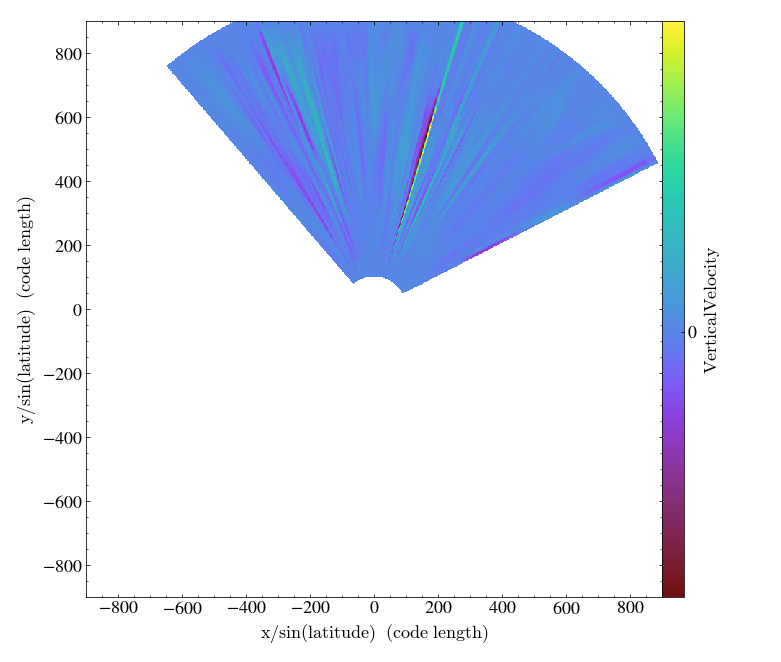

In [4]:
yt.SlicePlot(iso_12,'latitude','Vertical velocity')

yt : [INFO     ] 2022-06-27 14:34:56,160 xlim = 100.000000 1000.000000
yt : [INFO     ] 2022-06-27 14:34:56,167 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:34:56,169 Setting origin='native' for geographic geometry.
yt : [INFO     ] 2022-06-27 14:34:56,174 xlim = 100.000000 1000.000000
yt : [INFO     ] 2022-06-27 14:34:56,176 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:34:56,179 Making a fixed resolution buffer of (('stream', 'Vertical velocity')) 800 by 800
yt : [WARNING  ] 2022-06-27 14:34:56,701 Plotting ('stream', 'Vertical velocity'): Both positive and negative values. Min = -1.0270147323608398 dimensionless, Max = 0.9532060623168945 dimensionless.
yt : [WARNING  ] 2022-06-27 14:34:56,702 Switching to symlog colorbar scaling.



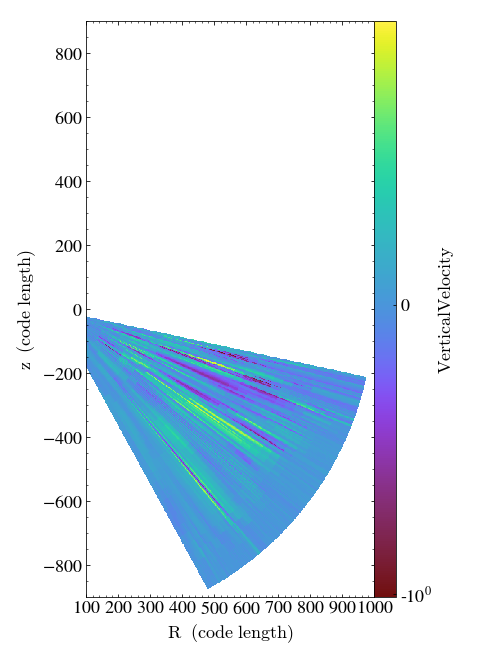

In [5]:
yt.SlicePlot(iso_12,'longitude','Vertical velocity')

yt : [INFO     ] 2022-06-27 14:35:01,856 xlim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:35:01,857 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:35:01,858 Setting origin='native' for geographic geometry.
yt : [INFO     ] 2022-06-27 14:35:01,859 xlim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:35:01,860 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:35:01,861 Making a fixed resolution buffer of (('stream', 'U component of wind')) 800 by 800
yt : [WARNING  ] 2022-06-27 14:35:02,153 Plotting ('stream', 'U component of wind'): Both positive and negative values. Min = -2.504486083984375 dimensionless, Max = 59.97066593170166 dimensionless.
yt : [WARNING  ] 2022-06-27 14:35:02,154 Switching to symlog colorbar scaling.



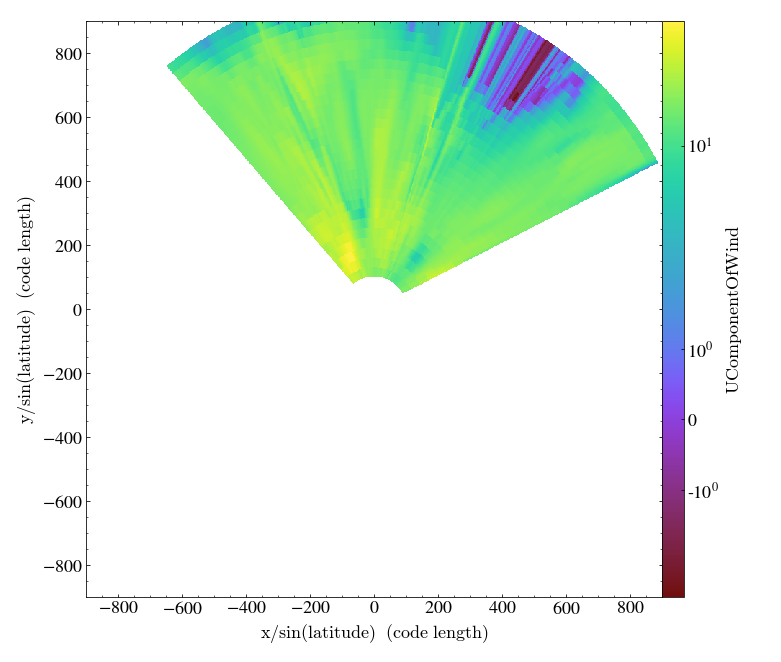

In [6]:
yt.SlicePlot(iso_12,'latitude','U component of wind')

yt : [INFO     ] 2022-06-27 14:35:11,700 xlim = 100.000000 1000.000000
yt : [INFO     ] 2022-06-27 14:35:11,701 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:35:11,701 Setting origin='native' for geographic geometry.
yt : [INFO     ] 2022-06-27 14:35:11,702 xlim = 100.000000 1000.000000
yt : [INFO     ] 2022-06-27 14:35:11,703 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:35:11,704 Making a fixed resolution buffer of (('stream', 'U component of wind')) 800 by 800
yt : [WARNING  ] 2022-06-27 14:35:12,205 Plotting ('stream', 'U component of wind'): Both positive and negative values. Min = -10.940109252929688 dimensionless, Max = 44.427852630615234 dimensionless.
yt : [WARNING  ] 2022-06-27 14:35:12,206 Switching to symlog colorbar scaling.



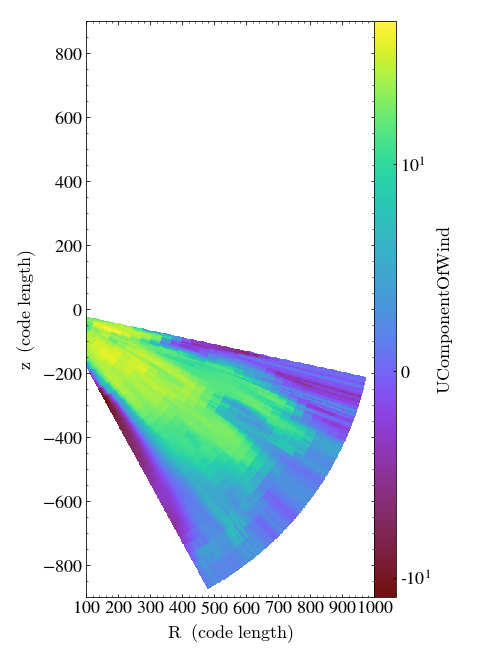

In [7]:
yt.SlicePlot(iso_12,'longitude','U component of wind')

yt : [INFO     ] 2022-06-27 14:35:16,235 xlim = 100.000000 1000.000000
yt : [INFO     ] 2022-06-27 14:35:16,237 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:35:16,238 Setting origin='native' for geographic geometry.
yt : [INFO     ] 2022-06-27 14:35:16,239 xlim = 100.000000 1000.000000
yt : [INFO     ] 2022-06-27 14:35:16,240 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:35:16,241 Making a fixed resolution buffer of (('stream', 'V component of wind')) 800 by 800
yt : [WARNING  ] 2022-06-27 14:35:16,764 Plotting ('stream', 'V component of wind'): Both positive and negative values. Min = -65.87730407714844 dimensionless, Max = 20.880172729492188 dimensionless.
yt : [WARNING  ] 2022-06-27 14:35:16,764 Switching to symlog colorbar scaling.



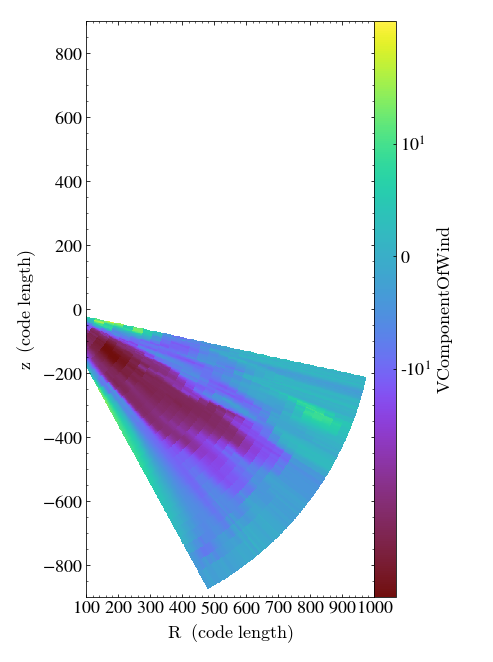

In [8]:
yt.SlicePlot(iso_12,'longitude','V component of wind')

yt : [INFO     ] 2022-06-27 14:35:18,276 xlim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:35:18,277 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:35:18,277 Setting origin='native' for geographic geometry.
yt : [INFO     ] 2022-06-27 14:35:18,279 xlim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:35:18,279 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:35:18,281 Making a fixed resolution buffer of (('stream', 'V component of wind')) 800 by 800
yt : [WARNING  ] 2022-06-27 14:35:18,567 Plotting ('stream', 'V component of wind'): Both positive and negative values. Min = -67.6865234375 dimensionless, Max = 81.74349975585938 dimensionless.
yt : [WARNING  ] 2022-06-27 14:35:18,567 Switching to symlog colorbar scaling.



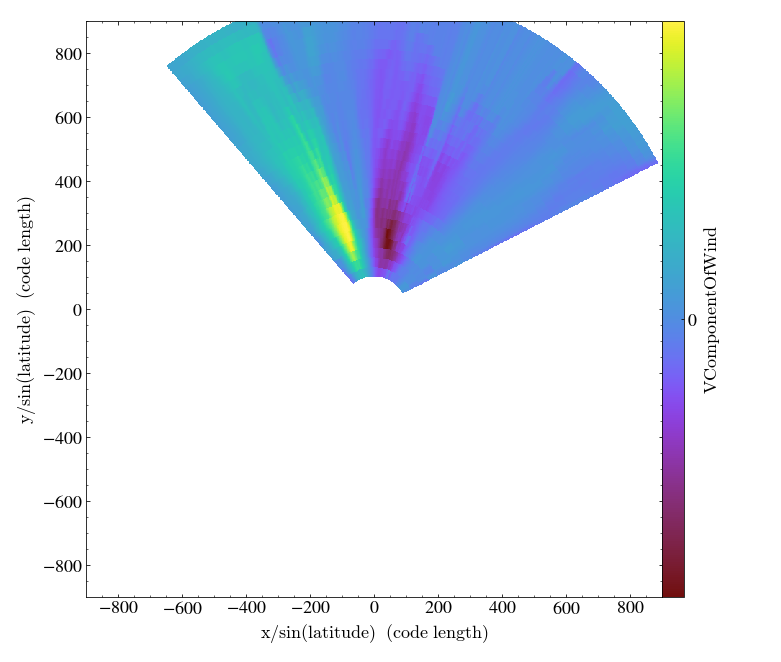

In [9]:
yt.SlicePlot(iso_12,'latitude','V component of wind')

yt : [INFO     ] 2022-06-27 14:35:20,025 xlim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:35:20,026 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:35:20,027 Setting origin='native' for geographic geometry.
yt : [INFO     ] 2022-06-27 14:35:20,030 xlim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:35:20,031 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:35:20,033 Making a fixed resolution buffer of (('stream', 'Temperature')) 800 by 800



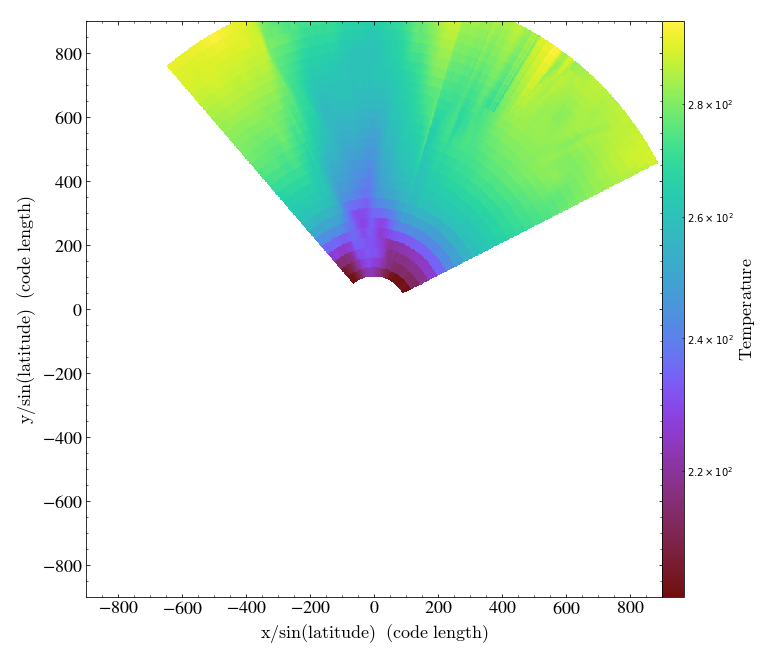

In [10]:
yt.SlicePlot(iso_12,'latitude','Temperature')

yt : [INFO     ] 2022-06-27 14:35:22,248 xlim = 100.000000 1000.000000
yt : [INFO     ] 2022-06-27 14:35:22,248 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:35:22,249 Setting origin='native' for geographic geometry.
yt : [INFO     ] 2022-06-27 14:35:22,250 xlim = 100.000000 1000.000000
yt : [INFO     ] 2022-06-27 14:35:22,251 ylim = -900.000000 900.000000
yt : [INFO     ] 2022-06-27 14:35:22,251 Making a fixed resolution buffer of (('stream', 'Temperature')) 800 by 800



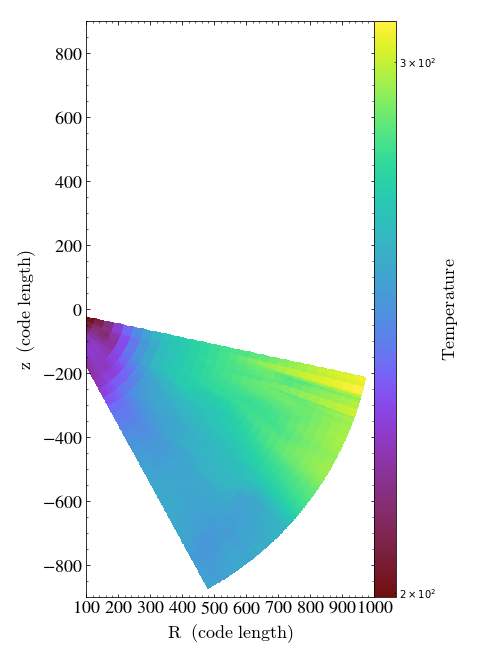

In [11]:
yt.SlicePlot(iso_12,'longitude','Temperature')

In [11]:
conus = pygrib.open('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2')
conus.seek(0)
grib_cols = ['messagenumber', 'name', 'units','gridType','typeOfLevel','level','forecastTime']
grib_key_df_w_time = pd.DataFrame([[getattr(grib,key) for key in grib_cols] for grib in conus], columns = grib_cols)
grib_key_df_w_time.set_index('messagenumber')
from natsort import index_natsorted
grib_key_df_w_time.sort_values(
   by="level",
   key=lambda x: np.argsort(index_natsorted(grib_key_df_w_time["level"])))

,messagenumber,name,units,gridType,typeOfLevel,level,forecastTime
6,7,MSLP (Eta model reduction),Pa,lambert,meanSea,0,0
10,11,Pressure reduced to MSL,Pa,lambert,meanSea,0,0
25,26,Surface pressure,Pa,lambert,surface,0,0
168,169,Categorical snow,(Code table 4.222),lambert,surface,0,0
179,180,Relative humidity,%,lambert,sigmaLayer,0,0
...,...,...,...,...,...,...,...
6508,6509,Convective inhibition,J kg**-1,lambert,pressureFromGroundLayer,18000,81
6546,6547,Best (4-layer) lifted index,K,lambert,pressureFromGroundLayer,18000,81
6735,6736,Best (4-layer) lifted index,K,lambert,pressureFromGroundLayer,18000,84
6736,6737,Convective inhibition,J kg**-1,lambert,pressureFromGroundLayer,18000,84


In [12]:
layers = ipywidgets.Dropdown(options = np.sort(grib_key_df_w_time.typeOfLevel.unique()))
layers

/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/traitlets/traitlets.py:588: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  silent = bool(old_value == new_value)


Dropdown(options=('atmosphereSingleLayer', 'heightAboveGround', 'heightAboveGroundLayer', 'hybrid', 'isobaricI…

In [13]:
forecastTimes = ipywidgets.SelectionSlider(options = np.sort(grib_key_df_w_time.forecastTime.unique()))
forecastTimes                                     

/Users/tzacks2/.conda/envs/DataViz/lib/python3.7/site-packages/traitlets/traitlets.py:588: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  silent = bool(old_value == new_value)


SelectionSlider(options=(0, 3, 6, 9, 12, 15, 18, 21, 24, 27, 30, 33, 36, 39, 42, 45, 48, 51, 54, 57, 60, 63, 6…

In [2]:
#Fixed level order - attempting other layer types

from natsort import index_natsorted
def yt_load(time,layer):
    grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','forecastTime','typeOfLevel')
    fcst_index=grbindx(forecastTime = time,typeOfLevel = layer)

    grib_cols = ['messagenumber', 'name', 'units','gridType','typeOfLevel','level']
    grib_key_df = pd.DataFrame([[getattr(grib,key) for key in grib_cols] for grib in fcst_index], columns = grib_cols)
    grib_key_df.set_index('messagenumber')
    
    grib_key_df = grib_key_df.sort_values(
       by="level",
       key=lambda x: np.argsort(index_natsorted(grib_key_df["level"])))

    fcst_index_dict={}
    for index,row in grib_key_df.iterrows():
        lev = str(grib_key_df.loc[grib_key_df['messagenumber']==row.messagenumber].level).split('\n')[0]
        lev = str(lev).split('    ')[1]
        var = str(grib_key_df.loc[grib_key_df['messagenumber']==row.messagenumber].name).split('\n')[0]
        var = str(var).split('    ')[1]
#         print(lev,var)

        fcst_index_dict[(row.messagenumber)-1]=(lev,var)
#     print(fcst_index_dict)
    variables = {x: {} for x in set(c[1] for c in fcst_index_dict.values()) }
    data = {}
    for ind, (level, var) in fcst_index_dict.items():
        variables[var][int(level)] = fcst_index[ind].data()[0]
    for variable in variables:
        data[variable] = np.stack([variables[variable][level] for level in sorted(variables[variable])], axis = -1)

#     print(data)
    latitude = fcst_index[0].data()[1]
    longitude = fcst_index[0].data()[2]
#     depth = np.sort(grib_key_df.level.unique())

    depth = grib_key_df.level.unique()
    print(len(latitude),len(longitude),len(depth))

    bbox = np.array([[latitude.min(), latitude.max()],
                    [longitude.min(),longitude.max()],
                     [depth.min(), depth.max()]],dtype='f8')
#     print(bbox)
    for var in variables:
        print(data[var].shape)
        if data[var].shape != (len(latitude), 614, len(depth)):
            data.pop(var)
#     ds = yt.load_uniform_grid(data, domain_dimensions = (428, 614, 29),bbox = bbox,
#                         geometry = ('geographic'))
    ds = yt.load_uniform_grid(data, domain_dimensions = (len(latitude), 614, 5),bbox = bbox,
                        geometry = ('geographic'))
#     print(ds)
    return ds

In [5]:
PressfromG_12 = yt_load(12,'pressureFromGroundLayer')
yt.SlicePlot(PressfromG_12,'longitude','V component of wind')

yt : [INFO     ] 2022-06-24 11:59:35,127 Parameters: current_time              = 0.0
yt : [INFO     ] 2022-06-24 11:59:35,128 Parameters: domain_dimensions         = [428 614   5]
yt : [INFO     ] 2022-06-24 11:59:35,128 Parameters: domain_left_edge          = [  12.19      -152.8786225 3000.       ]
yt : [INFO     ] 2022-06-24 11:59:35,128 Parameters: domain_right_edge         = [   61.30935757   -49.41598659 18000.        ]
yt : [INFO     ] 2022-06-24 11:59:35,129 Parameters: cosmological_simulation   = 0
yt : [INFO     ] 2022-06-24 11:59:35,196 Setting origin='native' for geographic geometry.


428 428 6
(428, 614, 1)
(428, 614, 5)
(428, 614, 1)
(428, 614, 5)
(428, 614, 1)
(428, 614, 1)
(428, 614, 5)
(428, 614, 5)


YTFieldNotFound: Could not find field ('unknown', 'V component of wind') in UniformGridData.

In [93]:
grbindx=pygrib.index('data/Boulder_Fire_Event/Model_Output/CONUS_12km_20090107_1200.grib2','forecastTime','typeOfLevel')
fcst_index=grbindx(forecastTime = 0,typeOfLevel = 'isobaricInhPa')

grib_cols = ['messagenumber', 'name', 'units','gridType','typeOfLevel','level']
grib_key_df = pd.DataFrame([[getattr(grib,key) for key in grib_cols] for grib in fcst_index], columns = grib_cols)
grib_key_df.set_index('messagenumber')

grib_key_df = grib_key_df.sort_values(
   by="level",
   key=lambda x: np.argsort(index_natsorted(grib_key_df["level"])))

fcst_index_dict={}
for index,row in grib_key_df.iterrows():
    lev = str(grib_key_df.loc[grib_key_df['messagenumber']==row.messagenumber].level).split('\n')[0]
    lev = str(lev).split('    ')[1]
    var = str(grib_key_df.loc[grib_key_df['messagenumber']==row.messagenumber].name).split('\n')[0]
    var = str(var).split('    ')[1]
#         print(lev,var)

    fcst_index_dict[(row.messagenumber)-1]=(lev,var)
#     print(fcst_index_dict)
variables = {x: {} for x in set(c[1] for c in fcst_index_dict.values()) }
data = {}
for ind, (level, var) in fcst_index_dict.items():
    variables[var][int(level)] = fcst_index[ind].data()[0]
for variable in variables:
    data[variable] = np.stack([variables[variable][level] for level in sorted(variables[variable])], axis = -1)

#     print(data)
latitude = fcst_index[2].data()[1]
longitude = fcst_index[2].data()[2]
#     depth = np.sort(grib_key_df.level.unique())

depth = grib_key_df.level.unique()

bbox = np.array([[latitude.min(), latitude.max()],
                [longitude.min(),longitude.max()],
                 [depth.min(), depth.max()]],dtype='f8')

In [98]:
#     print(bbox)
for var in variables:
    if data[var].shape != (len(latitude), 614, len(depth)):
        data.pop(var)
print(data)
        
#     print(data[var])
#         data.pop(var)

KeyError: 'Relative humidity'